#Kaggle Competition - Dstl Satellite Imagery Feature Detection

The aim of this notebook is to perform semantic image segmentation on satellite images from the [Kaggle Imagery Feature Detection challenge](https://www.kaggle.com/c/dstl-satellite-imagery-feature-detection). For now we'll only segment the Building class.

## Magics & Imports

In [1]:
!nvidia-smi

Tue Dec 10 15:09:07 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.36       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
# For better looking plots.
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

In [4]:
!pip install tifffile geopandas rasterio torch-lr-finder kaggle

     |████████████████████████████████| 133kB 4.7MB/s 
     |████████████████████████████████| 921kB 45.3MB/s 
     |████████████████████████████████| 15.2MB 42.5MB/s 
     |████████████████████████████████| 706kB 48.1MB/s 
     |████████████████████████████████| 10.1MB 42.8MB/s 
     |████████████████████████████████| 11.8MB 33.9MB/s 


In [5]:
import pandas as pd
import numpy as np
import cv2

from shapely.wkt import loads as wkt_loads
from shapely.geometry import Polygon
from shapely import affinity

import tifffile
from zipfile import ZipFile
import os

from pathlib import Path
import matplotlib.pyplot as plt

import geopandas
from geopandas import GeoSeries

import rasterio
import rasterio.mask
from rasterio.enums import Resampling

import random
from functools import partial, partialmethod

from PIL import Image

import warnings

import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F

import torchvision

from torch_lr_finder import LRFinder

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

from tqdm.auto import tqdm, trange

from collections import defaultdict

from datetime import datetime

from concurrent.futures import ThreadPoolExecutor

from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import StandardScaler

import gc

from skimage import io

/usr/local/lib/python3.6/dist-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


## Get the data

In [6]:
# Import kaggle.json from Google Drive
# This snippet will output a link which needs authentication from any Google account
# Source: https://gist.github.com/ViveK-PothinA/04153012dcff6b39d6ddb96d2680269c#file-colab_helper_1-py
from googleapiclient.discovery import build
import io, os
from googleapiclient.http import MediaIoBaseDownload
from google.colab import auth

auth.authenticate_user()

drive_service = build('drive', 'v3')
results = drive_service.files().list(
        q="name = 'kaggle.json'", fields="files(id)").execute()
kaggle_api_key = results.get('files', [])

filename = "/root/.kaggle/kaggle.json"
os.makedirs(os.path.dirname(filename), exist_ok=True)

request = drive_service.files().get_media(fileId=kaggle_api_key[0]['id'])
fh = io.FileIO(filename, 'wb')
downloader = MediaIoBaseDownload(fh, request)
done = False
while done is False:
    status, done = downloader.next_chunk()
    print("Download %d%%." % int(status.progress() * 100))
os.chmod(filename, 600)

Download 100%.


In [7]:
!kaggle competitions download -c dstl-satellite-imagery-feature-detection -p ~/data/dstl/

  0% 0.00/14.9k [00:00<?, ?B/s]
100% 14.9k/14.9k [00:00<00:00, 31.6MB/s]
  0% 0.00/2.17k [00:00<?, ?B/s]
100% 2.17k/2.17k [00:00<00:00, 1.40MB/s]
100% 7.29G/7.30G [02:16<00:00, 53.7MB/s]
100% 7.30G/7.30G [02:16<00:00, 57.4MB/s]
100% 12.9G/12.9G [03:59<00:00, 53.0MB/s]
100% 12.9G/12.9G [03:59<00:00, 57.7MB/s]
 63% 9.00M/14.2M [00:00<00:00, 21.0MB/s]
100% 14.2M/14.2M [00:00<00:00, 28.9MB/s]
 45% 5.00M/11.1M [00:00<00:00, 31.7MB/s]
100% 11.1M/11.1M [00:00<00:00, 54.3MB/s]


In [8]:
rootDir = Path("/root/data/dstl")
!ls "{rootDir.resolve()}"

grid_sizes.csv.zip	   sixteen_band.zip  train_geojson_v3.zip
sample_submission.csv.zip  three_band.zip    train_wkt_v4.csv.zip


In [0]:
# Unzip (quietly) and delete .zip file.
!unzip -qq /root/data/dstl/three_band.zip -d /root/data/dstl/
!rm /root/data/dstl/three_band.zip

In [10]:
!ls "{rootDir.resolve()}"

grid_sizes.csv.zip	   sixteen_band.zip  train_geojson_v3.zip
sample_submission.csv.zip  three_band	     train_wkt_v4.csv.zip


In [0]:
!unzip -qq /root/data/dstl/sixteen_band.zip -d /root/data/dstl/
!rm /root/data/dstl/sixteen_band.zip

In [12]:
!ls "{rootDir.resolve()}"

grid_sizes.csv.zip	   sixteen_band  train_geojson_v3.zip
sample_submission.csv.zip  three_band	 train_wkt_v4.csv.zip


In [13]:
from google.colab import drive
drive.mount('/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /gdrive


In [0]:
projectPath = Path("/gdrive/My Drive/Colab_ML/projects/Kaggle_Dstl_Satellite_Imagery_Feature_Detection")

## Functions to read masks and display uint16 images

In [0]:
DF = pd.read_csv(rootDir / 'train_wkt_v4.csv.zip')
GS = pd.read_csv(rootDir / 'grid_sizes.csv.zip', names=['ImageId', 'Xmax', 'Ymin'], skiprows=1)

def _convert_coordinates_to_raster(coords, img_size, xymax):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    Xmax, Ymax = xymax
    H, W = img_size
    W1 = 1.0 * W * W / (W + 1)
    H1 = 1.0 * H * H / (H + 1)
    xf = W1 / Xmax
    yf = H1 / Ymax
    coords[:, 1] *= yf
    coords[:, 0] *= xf
    coords_int = np.round(coords).astype(np.int32)
    return coords_int


def _get_xmax_ymin(grid_sizes_panda, imageId):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    xmax, ymin = grid_sizes_panda[grid_sizes_panda.ImageId == imageId].iloc[0, 1:].astype(float)
    return (xmax, ymin)


def _get_polygon_list(wkt_list_pandas, imageId, cType):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    df_image = wkt_list_pandas[wkt_list_pandas.ImageId == imageId]
    multipoly_def = df_image[df_image.ClassType == cType].MultipolygonWKT
    polygonList = None
    if len(multipoly_def) > 0:
        assert len(multipoly_def) == 1
        polygonList = wkt_loads(multipoly_def.values[0])
    return polygonList


def _get_and_convert_contours(polygonList, raster_img_size, xymax):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    perim_list = []
    interior_list = []
    if polygonList is None:
        return None
    for k in range(len(polygonList)):
        poly = polygonList[k]
        perim = np.array(list(poly.exterior.coords))
        perim_c = _convert_coordinates_to_raster(perim, raster_img_size, xymax)
        perim_list.append(perim_c)
        for pi in poly.interiors:
            interior = np.array(list(pi.coords))
            interior_c = _convert_coordinates_to_raster(interior, raster_img_size, xymax)
            interior_list.append(interior_c)
    return perim_list, interior_list


def _plot_mask_from_contours(raster_img_size, contours, class_value=1):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    img_mask = np.zeros(raster_img_size, np.uint8)
    if contours is None:
        return img_mask
    perim_list, interior_list = contours
    cv2.fillPoly(img_mask, perim_list, class_value)
    cv2.fillPoly(img_mask, interior_list, 0)
    return img_mask


def generate_mask_for_image_and_class(raster_size, imageId, class_type=1, grid_sizes_panda=GS, wkt_list_pandas=DF):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    xymax = _get_xmax_ymin(grid_sizes_panda, imageId)
    polygon_list = _get_polygon_list(wkt_list_pandas, imageId, class_type)
    contours = _get_and_convert_contours(polygon_list, raster_size, xymax)
    mask = _plot_mask_from_contours(raster_size, contours, 1)
    return mask

def M(image_id): 
    # __author__ = amaia
    # https://www.kaggle.com/aamaia/dstl-satellite-imagery-feature-detection/rgb-using-m-bands-example
    filename = os.path.join(rootDir / "three_band", '{}.tif'.format(image_id))
    img = tifffile.imread(filename)
    img = np.rollaxis(img, 0, 3)
    return img

def M_sixteen_band(image_id, channel="M"):
    filename = os.path.join(rootDir / "sixteen_band", '{}_{}.tif'.format(image_id, channel))
    img = tifffile.imread(filename)
    img = np.rollaxis(img, 0, 3)
    return img


def stretch_n(bands, lower_percent=5, higher_percent=95):
    # https://www.kaggle.com/drn01z3/end-to-end-baseline-with-u-net-keras
    out = np.zeros_like(bands)
    n = bands.shape[2]
    for i in range(n):
        a = np.min(bands[:, :, i])
        b = np.max(bands[:, :, i]) 
        c = np.percentile(bands[:, :, i], lower_percent)
        d = np.percentile(bands[:, :, i], higher_percent)
        t = a + (bands[:, :, i] - c) * (b - a) / (d - c)
        t[t < a] = a
        t[t > b] = b
        out[:, :, i] = t
    return out.astype(np.float32)

## Exploration

In [17]:
threeBandImagesDir = rootDir / "three_band"
!ls "{threeBandImagesDir.resolve()}" | wc -l
!ls "{threeBandImagesDir.resolve()}" | head -10

450
6010_0_0.tif
6010_0_1.tif
6010_0_2.tif
6010_0_3.tif
6010_0_4.tif
6010_1_0.tif
6010_1_1.tif
6010_1_2.tif
6010_1_3.tif
6010_1_4.tif


In [18]:
sixteenBandImagesDir = rootDir / "sixteen_band"
!ls "{sixteenBandImagesDir.resolve()}" | wc -l
!ls "{sixteenBandImagesDir.resolve()}" | head -10

1350
6010_0_0_A.tif
6010_0_0_M.tif
6010_0_0_P.tif
6010_0_1_A.tif
6010_0_1_M.tif
6010_0_1_P.tif
6010_0_2_A.tif
6010_0_2_M.tif
6010_0_2_P.tif
6010_0_3_A.tif


In [0]:
df_train_val_all_classes = pd.read_csv(rootDir / "train_wkt_v4.csv.zip")

In [20]:
df_train_val_all_classes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 250 entries, 0 to 249
Data columns (total 3 columns):
ImageId            250 non-null object
ClassType          250 non-null int64
MultipolygonWKT    250 non-null object
dtypes: int64(1), object(2)
memory usage: 6.0+ KB


In [21]:
df_train_val_all_classes.describe()

,ClassType
count,250.000000
mean,5.500000
std,2.878043
min,1.000000
25%,3.000000
50%,5.500000
75%,8.000000
max,10.000000


In [22]:
df_train_val_all_classes.ImageId.nunique()

25

In [23]:
df_train_val_all_classes.head()

,ImageId,ClassType,MultipolygonWKT
0,6040_2_2,1,MULTIPOLYGON EMPTY
1,6040_2_2,2,MULTIPOLYGON EMPTY
2,6040_2_2,3,MULTIPOLYGON EMPTY
3,6040_2_2,4,MULTIPOLYGON (((0.003025 -0.007879000000000001...
4,6040_2_2,5,MULTIPOLYGON (((0.005311 -0.009044999999999999...


In [0]:
def parse_images(imgDir=threeBandImagesDir):
    data = []

    for img_path in imgDir.iterdir():
        imageId = img_path.stem
        img = M(imageId)

        img_data = {
            "ImageId": imageId,
            "height": img.shape[0],
            "width": img.shape[1],
            "depth": img.shape[2],
            "img_channel_max": np.array([img[:, :, channel].max() for channel in range(img.shape[2])]),
            "img_channel_min": np.array([img[:, :, channel].min() for channel in range(img.shape[2])])
            }

        data.append(img_data)

    return pd.DataFrame(data)

In [25]:
%%time
df_img_data = parse_images(threeBandImagesDir)

CPU times: user 55.4 s, sys: 21.1 s, total: 1min 16s
Wall time: 3min 41s


In [26]:
df_img_data.head()

,ImageId,height,width,depth,img_channel_max,img_channel_min
0,6010_4_0,3345,3396,3,"[583, 635, 402]","[282, 362, 275]"
1,6160_1_3,3349,3393,3,"[836, 702, 490]","[292, 317, 258]"
2,6130_4_1,3348,3396,3,"[959, 811, 549]","[457, 429, 317]"
3,6140_4_2,3348,3396,3,"[819, 632, 424]","[427, 411, 314]"
4,6060_4_0,3348,3403,3,"[915, 954, 612]","[332, 519, 422]"


In [27]:
# Calculate min/max channel values
img_mins = np.min(df_img_data.img_channel_min.to_list(), axis=0)
img_maxs = np.max(df_img_data.img_channel_max.to_list(), axis=0)
print(f"Training Image Channel min-values: {img_mins}")
print(f"Training Image Channel max-values: {img_maxs}")

Training Image Channel min-values: [ 1 68 43]
Training Image Channel max-values: [2047 2047 2047]


## Adversarial Validation 

To help us choose a validation and training sets that are representative of the test set, we will train a classifier to predict if a given image belongs to the testset. If the training and testsets came from the same underlying distribution, it would be impossible for such a classifier to distinguish between sample from either set (i.e: roc_auc = 0.5).

In [0]:
df_train_val_img_data = df_img_data.loc[df_img_data.ImageId.isin(df_train_val_all_classes.ImageId.unique())]
df_test_img_data =  df_img_data.loc[~df_img_data.ImageId.isin(df_train_val_all_classes.ImageId.unique())]

In [29]:
df_train_val_img_data.shape

(25, 6)

In [30]:
df_test_img_data.shape

(425, 6)

In [0]:
imagenet_means = [0.485, 0.456, 0.406]
imagenet_stds = [0.229, 0.224, 0.225]

In [0]:
class ImgMinMaxScaler:
    def __init__(self, channel_min, channel_max):
        self.channel_min = channel_min
        self.channel_max = channel_max

    def __call__(self, X):
        return (X - self.channel_min) / (self.channel_max - self.channel_min)

class ImgToTensor:
    def __call__(self, X):
        return torchvision.transforms.functional.to_tensor(X.astype(np.float32))

class ImgResize:
    def __init__(self, dst_size):
        self.dst_size = dst_size

    def __call__(self, X):
        return cv2.resize(X, self.dst_size, interpolation=cv2.INTER_AREA)

class AdversarialDataSet(Dataset):
    def __init__(self, train_img_ids, test_img_ids, transform=None):
        super(AdversarialDataSet, self).__init__()
        self.train_img_ids = train_img_ids
        self.test_img_ids = test_img_ids
        self.transform = transform

    def __len__(self):
        return len(self.train_img_ids) + len(self.test_img_ids)

    def __getitem__(self, index):
        is_test_img = np.random.randint(0, 2)
        img_id = np.random.choice(self.test_img_ids if is_test_img else self.train_img_ids)

        img = M(img_id)

        if self.transform is not None:
            img = self.transform(img)

        return img, torch.as_tensor(is_test_img)

class TiffImgDataset(Dataset):
    def __init__(self, img_ids, transform=None):
        super(TiffImgDataset, self).__init__()
        self.img_ids = img_ids
        self.transform = transform

    def __len__(self):
        return len(self.img_ids)

    def __getitem__(self, index):
        img = M(self.img_ids[index])

        if self.transform is not None:
            img = self.transform(img)

        return img

In [0]:
tf_adversarial = torchvision.transforms.Compose([
    ImgMinMaxScaler(channel_min=img_mins, channel_max=img_maxs),
    ImgResize((300, 300)),
    ImgToTensor(),
    torchvision.transforms.Normalize(mean=imagenet_means, std=imagenet_stds)
])

ds_adversarial = AdversarialDataSet(train_img_ids=df_train_val_img_data.ImageId, 
                                    test_img_ids=df_test_img_data.ImageId, 
                                    transform=tf_adversarial)

In [0]:
dl_adversarial = DataLoader(ds_adversarial, batch_size=32, num_workers=8)

In [0]:
adv_model = torchvision.models.resnet18(pretrained=True)
adv_model.fc = nn.Sequential(nn.Linear(512, 1))
adv_model.to("cuda")
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(adv_model.parameters(), lr=1e-3)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/checkpoints/resnet18-5c106cde.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 75.4MB/s]


In [0]:
def train(num_epochs, model=adv_model, criterion=criterion, optimizer=optimizer, dl=dl_adversarial, device="cuda"):
    model.train()
    for epoch in trange(num_epochs, desc="Epochs", leave=False):
        running_loss = 0
        for img, label in tqdm(dl, desc=f"Epoch {epoch}", leave=False,  position=0):
            
            img, label = img.to(device), label.to(device)

            optimizer.zero_grad()

            pred_logits = model(img).squeeze()

            loss = criterion(pred_logits, label.type(torch.float32))

            running_loss += loss.item() * img.size(0) / len(dl.dataset)

            loss.backward()
            optimizer.step()

        tqdm.write(f"Epoch {epoch}: loss={running_loss:.6f}")

In [0]:
train(6)

Epoch 0: loss=0.324983


Epoch 1: loss=0.197665


Epoch 2: loss=0.183503


Epoch 3: loss=0.072210


Epoch 4: loss=0.024486


Epoch 5: loss=0.008536


In [0]:
ds_adversarial_complete = TiffImgDataset(img_ids=df_train_val_img_data.ImageId.to_list() + df_test_img_data.ImageId.to_list(), transform=tf_adversarial)

In [0]:
dl_adversarial_complete = DataLoader(ds_adversarial_complete, num_workers=8)

In [0]:
def validate(model=adv_model, dl=dl_adversarial_complete, device="cuda"):
    model.eval()

    prediction = []
    with torch.no_grad():
        for img in tqdm(dl, desc="Validating", leave=False):
            img = img.to(device)
            pred = torch.sigmoid(model(img).squeeze(0))
            prediction.append(pred)

    return torch.cat(prediction)

In [0]:
pred = validate()

In [0]:
pred = pred.cpu().numpy()

In [0]:
target = np.concatenate([np.zeros(len(df_train_val_img_data.ImageId)), np.ones(len(df_test_img_data.ImageId))])

In [0]:
roc_auc_score(target, pred)

0.8432

We can see that even training for just 10 epochs on images that are only 300 by 300, the model's predictions are far better than random, indicating that the training and test sets do not have the same underlying data-distribution. Still we can choose those sample-images from the training set as validation images for which the model's confidence for belonging to the test set was highest.

In [0]:
len(df_train_val_img_data.ImageId)

25

In [0]:
np.argsort(pred[:25])

array([ 7,  4,  8,  3, 19, 10,  1, 21, 12, 24, 11, 22, 16, 13, 18,  9, 23,
       20, 17,  5, 15, 14,  2,  0,  6])

In [0]:
np.sort(pred[:25])

array([2.0507311e-16, 7.9112293e-11, 1.1524346e-10, 5.1407945e-10,
       6.6109060e-09, 3.9528885e-08, 2.6458085e-07, 9.2549101e-07,
       9.3603767e-06, 2.0511718e-04, 4.1029861e-04, 7.6810922e-04,
       1.4553963e-03, 5.2522505e-03, 1.2758911e-02, 4.1444708e-02,
       4.5253524e-01, 5.0921100e-01, 5.3941655e-01, 6.1709815e-01,
       9.9234688e-01, 9.9375314e-01, 9.9770337e-01, 9.9777466e-01,
       9.9992323e-01], dtype=float32)

In [0]:
df_train_val_img_data = df_train_val_img_data.iloc[np.argsort(pred[:25])]

In [0]:
df_train_val_img_data.loc[:, "test_similarity"] = np.sort(pred[:25])

In [0]:
df_train_val_img_data

,ImageId,height,width,depth,img_channel_max,img_channel_min,test_similarity
96,6120_2_2,3348,3403,3,"[2047, 2034, 1539]","[463, 396, 303]",2.050731e-16
79,6110_4_0,3348,3396,3,"[2047, 2047, 1813]","[151, 360, 256]",7.911229e-11
114,6150_2_3,3348,3403,3,"[964, 693, 438]","[435, 419, 307]",1.152435e-10
52,6100_2_3,3349,3391,3,"[1728, 1973, 1717]","[1, 157, 91]",5.140794e-10
344,6100_1_3,3349,3391,3,"[1794, 1912, 1762]","[47, 198, 118]",6.610906e-09
149,6120_2_0,3348,3403,3,"[1406, 1035, 691]","[490, 431, 311]",3.952889e-08
6,6110_3_1,3348,3396,3,"[2047, 2047, 2047]","[193, 371, 315]",2.645808e-07
372,6010_4_4,3345,3393,3,"[542, 605, 400]","[265, 351, 268]",9.254910e-07
187,6100_2_2,3349,3391,3,"[1717, 1949, 1664]","[76, 215, 154]",9.360377e-06
445,6040_2_2,3349,3391,3,"[474, 552, 389]","[243, 347, 265]",2.051172e-04


## Buildings

In [0]:
df_train_val_buildings = df_train_val_all_classes[df_train_val_all_classes.ClassType == 1]

In [0]:
df_train_val_buildings

,ImageId,ClassType,MultipolygonWKT
0,6040_2_2,1,MULTIPOLYGON EMPTY
10,6120_2_2,1,MULTIPOLYGON (((0.000439 -0.009039999999999999...
20,6120_2_0,1,"MULTIPOLYGON (((0.005324 -0.002879, 0.005327 -..."
30,6090_2_0,1,MULTIPOLYGON EMPTY
40,6040_1_3,1,MULTIPOLYGON EMPTY
50,6040_1_0,1,MULTIPOLYGON EMPTY
60,6100_1_3,1,"MULTIPOLYGON (((0.000748 -0.009042, 0.000745 -..."
70,6010_4_2,1,MULTIPOLYGON EMPTY
80,6110_4_0,1,"MULTIPOLYGON (((0.007546 -0.005158, 0.007584 -..."
90,6140_3_1,1,MULTIPOLYGON (((0.0041385419488102 -0.00889310...


In [0]:
def parse_mask_data(df):
    new_df = df.copy()

    num_polygons = []
    img_building_area_ratio = []

    for i in range(len(df)):
        polygons = wkt_loads(df.iloc[i].MultipolygonWKT)
        num_polygons.append(len(polygons))

        imageId = df.iloc[i].ImageId
        img = M(imageId)

        mask = generate_mask_for_image_and_class(img.shape[:2], imageId)
        img_building_area_ratio.append(np.mean(mask))


    new_df["NumPolygons"] = num_polygons
    new_df["BuildingAreaRatio"] = img_building_area_ratio

    return new_df

In [0]:
df_train_val_buildings = parse_mask_data(df_train_val_buildings)

In [0]:
df_train_val_buildings = df_train_val_buildings.join(df_train_val_img_data.set_index('ImageId'), on='ImageId')

In [0]:
df_train_val_buildings.to_csv(projectPath / "df_train_val_buildings.csv", index=False)

### Load buildings DataFrame

In [0]:
df_train_val_buildings = pd.read_csv(projectPath / "df_train_val_buildings.csv")

In [33]:
df_train_val_buildings

,ImageId,ClassType,MultipolygonWKT,NumPolygons,BuildingAreaRatio,height,width,depth,img_channel_max,img_channel_min,test_similarity
0,6040_2_2,1,MULTIPOLYGON EMPTY,0,0.000000,3349,3391,3,[474 552 389],[243 347 265],2.051172e-04
1,6120_2_2,1,MULTIPOLYGON (((0.000439 -0.009039999999999999...,1962,0.220120,3348,3403,3,[2047 2034 1539],[463 396 303],2.050731e-16
2,6120_2_0,1,"MULTIPOLYGON (((0.005324 -0.002879, 0.005327 -...",573,0.019938,3348,3403,3,[1406 1035 691],[490 431 311],3.952889e-08
3,6090_2_0,1,MULTIPOLYGON EMPTY,0,0.000000,3349,3393,3,[856 650 410],[ 91 209 186],9.937531e-01
4,6040_1_3,1,MULTIPOLYGON EMPTY,0,0.000000,3349,3391,3,[556 606 401],[248 345 268],1.455396e-03
5,6040_1_0,1,MULTIPOLYGON EMPTY,0,0.000000,3349,3391,3,[470 532 371],[256 350 273],6.170982e-01
6,6100_1_3,1,"MULTIPOLYGON (((0.000748 -0.009042, 0.000745 -...",2208,0.095122,3349,3391,3,[1794 1912 1762],[ 47 198 118],6.610906e-09
7,6010_4_2,1,MULTIPOLYGON EMPTY,0,0.000000,3345,3396,3,[569 624 409],[278 358 274],9.999232e-01
8,6110_4_0,1,"MULTIPOLYGON (((0.007546 -0.005158, 0.007584 -...",437,0.026021,3348,3396,3,[2047 2047 1813],[151 360 256],7.911229e-11
9,6140_3_1,1,MULTIPOLYGON (((0.0041385419488102 -0.00889310...,565,0.055425,3348,3396,3,[2047 1933 1460],[432 414 289],5.092110e-01


In [34]:
df_train_val_buildings[df_train_val_buildings.NumPolygons == 0].sort_values(by="test_similarity")

,ImageId,ClassType,MultipolygonWKT,NumPolygons,BuildingAreaRatio,height,width,depth,img_channel_max,img_channel_min,test_similarity
12,6150_2_3,1,MULTIPOLYGON EMPTY,0,0.0,3348,3403,3,[964 693 438],[435 419 307],1.152435e-10
16,6010_4_4,1,MULTIPOLYGON EMPTY,0,0.0,3345,3393,3,[542 605 400],[265 351 268],9.254910e-07
0,6040_2_2,1,MULTIPOLYGON EMPTY,0,0.0,3349,3391,3,[474 552 389],[243 347 265],2.051172e-04
19,6170_0_4,1,MULTIPOLYGON EMPTY,0,0.0,3349,3389,3,[758 601 374],[110 210 187],7.681092e-04
4,6040_1_3,1,MULTIPOLYGON EMPTY,0,0.0,3349,3391,3,[556 606 401],[248 345 268],1.455396e-03
13,6160_2_1,1,MULTIPOLYGON EMPTY,0,0.0,3349,3393,3,[829 676 479],[281 313 261],5.252251e-03
17,6170_2_4,1,MULTIPOLYGON EMPTY,0,0.0,3349,3389,3,[766 621 385],[116 212 185],1.275891e-02
22,6010_1_2,1,MULTIPOLYGON EMPTY,0,0.0,3349,3396,3,[605 643 409],[299 381 282],4.144471e-02
5,6040_1_0,1,MULTIPOLYGON EMPTY,0,0.0,3349,3391,3,[470 532 371],[256 350 273],6.170982e-01
23,6040_4_4,1,MULTIPOLYGON EMPTY,0,0.0,3346,3387,3,[514 576 387],[270 364 278],9.923469e-01


In [35]:
df_train_val_buildings[df_train_val_buildings.NumPolygons != 0].sort_values(by="test_similarity")

,ImageId,ClassType,MultipolygonWKT,NumPolygons,BuildingAreaRatio,height,width,depth,img_channel_max,img_channel_min,test_similarity
1,6120_2_2,1,MULTIPOLYGON (((0.000439 -0.009039999999999999...,1962,0.220120,3348,3403,3,[2047 2034 1539],[463 396 303],2.050731e-16
8,6110_4_0,1,"MULTIPOLYGON (((0.007546 -0.005158, 0.007584 -...",437,0.026021,3348,3396,3,[2047 2047 1813],[151 360 256],7.911229e-11
11,6100_2_3,1,MULTIPOLYGON (((0.008963998153499299 -0.009041...,1690,0.088468,3349,3391,3,[1728 1973 1717],[ 1 157 91],5.140794e-10
6,6100_1_3,1,"MULTIPOLYGON (((0.000748 -0.009042, 0.000745 -...",2208,0.095122,3349,3391,3,[1794 1912 1762],[ 47 198 118],6.610906e-09
2,6120_2_0,1,"MULTIPOLYGON (((0.005324 -0.002879, 0.005327 -...",573,0.019938,3348,3403,3,[1406 1035 691],[490 431 311],3.952889e-08
15,6110_3_1,1,MULTIPOLYGON (((0.0040671780447186 -0.00889538...,581,0.048537,3348,3396,3,[2047 2047 2047],[193 371 315],2.645808e-07
24,6100_2_2,1,"MULTIPOLYGON (((0.007676 -0.005554, 0.007721 -...",633,0.034318,3349,3391,3,[1717 1949 1664],[ 76 215 154],9.360377e-06
10,6110_1_2,1,MULTIPOLYGON (((5.99993550571e-05 -0.009031902...,1584,0.140139,3348,3396,3,[2047 2047 2047],[ 27 360 321],4.102986e-04
14,6140_1_2,1,MULTIPOLYGON (((0.000102 -0.009039999999999999...,1607,0.137961,3348,3396,3,[2047 1986 1425],[400 410 261],4.525352e-01
9,6140_3_1,1,MULTIPOLYGON (((0.0041385419488102 -0.00889310...,565,0.055425,3348,3396,3,[2047 1933 1460],[432 414 289],5.092110e-01


In [0]:
val_img_ids = ["6100_2_2", "6140_3_1"]

In [0]:
df_val_buildings = df_train_val_buildings[df_train_val_buildings.ImageId.isin(val_img_ids)]
df_train_buildings = df_train_val_buildings[~df_train_val_buildings.ImageId.isin(val_img_ids) & df_train_val_buildings.NumPolygons != 0]

In [38]:
df_val_buildings.shape

(2, 11)

In [39]:
df_train_buildings.shape

(5, 11)

In [40]:
df_val_buildings.describe()

,ClassType,NumPolygons,BuildingAreaRatio,height,width,depth,test_similarity
count,2.0,2.000000,2.000000,2.000000,2.000000,2.0,2.000000
mean,1.0,599.000000,0.044872,3348.500000,3393.500000,3.0,0.254610
std,0.0,48.083261,0.014925,0.707107,3.535534,0.0,0.360060
min,1.0,565.000000,0.034318,3348.000000,3391.000000,3.0,0.000009
25%,1.0,582.000000,0.039595,3348.250000,3392.250000,3.0,0.127310
50%,1.0,599.000000,0.044872,3348.500000,3393.500000,3.0,0.254610
75%,1.0,616.000000,0.050148,3348.750000,3394.750000,3.0,0.381911
max,1.0,633.000000,0.055425,3349.000000,3396.000000,3.0,0.509211


In [41]:
df_train_buildings.describe()

,ClassType,NumPolygons,BuildingAreaRatio,height,width,depth,test_similarity
count,5.0,5.000000,5.000000,5.000000,5.000000,5.0,5.000000e+00
mean,1.0,661.400000,0.049731,3348.400000,3385.800000,3.0,2.900478e-01
std,0.0,562.125253,0.050893,0.894427,26.892378,0.0,4.414639e-01
min,1.0,109.000000,0.016197,3348.000000,3338.000000,3.0,7.911229e-11
25%,1.0,437.000000,0.019938,3348.000000,3396.000000,3.0,3.952889e-08
50%,1.0,573.000000,0.026021,3348.000000,3396.000000,3.0,2.645808e-07
75%,1.0,581.000000,0.048537,3348.000000,3396.000000,3.0,4.525352e-01
max,1.0,1607.000000,0.137961,3350.000000,3403.000000,3.0,9.977034e-01


## Visualization

In [0]:
def show_image(imageId, fig=None, ax=None):
    do_show = False

    if fig is None or ax is None:
        fig, ax = plt.subplots(figsize=(10, 10))
        do_show = True
    
    img = M(imageId)
    img_color_stretched = stretch_n(img)
    tifffile.imshow(img_color_stretched, figure=fig, subplot=ax)
    ax.axis("off")
    
    if do_show:
        plt.show()

def show_image_channel(imageId, channel="M", fig=None, ax=None):
    do_show = False

    if fig is None or ax is None:
        fig, ax = plt.subplots(figsize=(10, 10))
        do_show = True
    
    img = M_sixteen_band(imageId, channel=channel)
    img_color_stretched = stretch_n(img)
    tifffile.imshow(img_color_stretched, figure=fig, subplot=ax)
    ax.axis("off")
    
    if do_show:
        plt.show()

def show_images(imageIds=df_train_buildings.iloc[:4].ImageId, n_max_cols=2, single_img_size=(6, 6)):
    n_images = len(imageIds)
    n_plot_cols = n_max_cols
    n_plot_rows = int((n_images - 1) / n_plot_cols + 1)
    fig, ax = plt.subplots(nrows=n_plot_rows, ncols=n_plot_cols, 
                           figsize=(n_plot_cols * single_img_size[0], 
                                    n_plot_rows * single_img_size[1]))
    
    for i, imageId in enumerate(imageIds):
        img_ax = ax[i // n_plot_cols][i % n_plot_cols]
        show_image(imageId, fig, img_ax)

    plt.tight_layout(pad=0.0, w_pad=0.6, h_pad=0.6)
    plt.show()
    gc.collect()

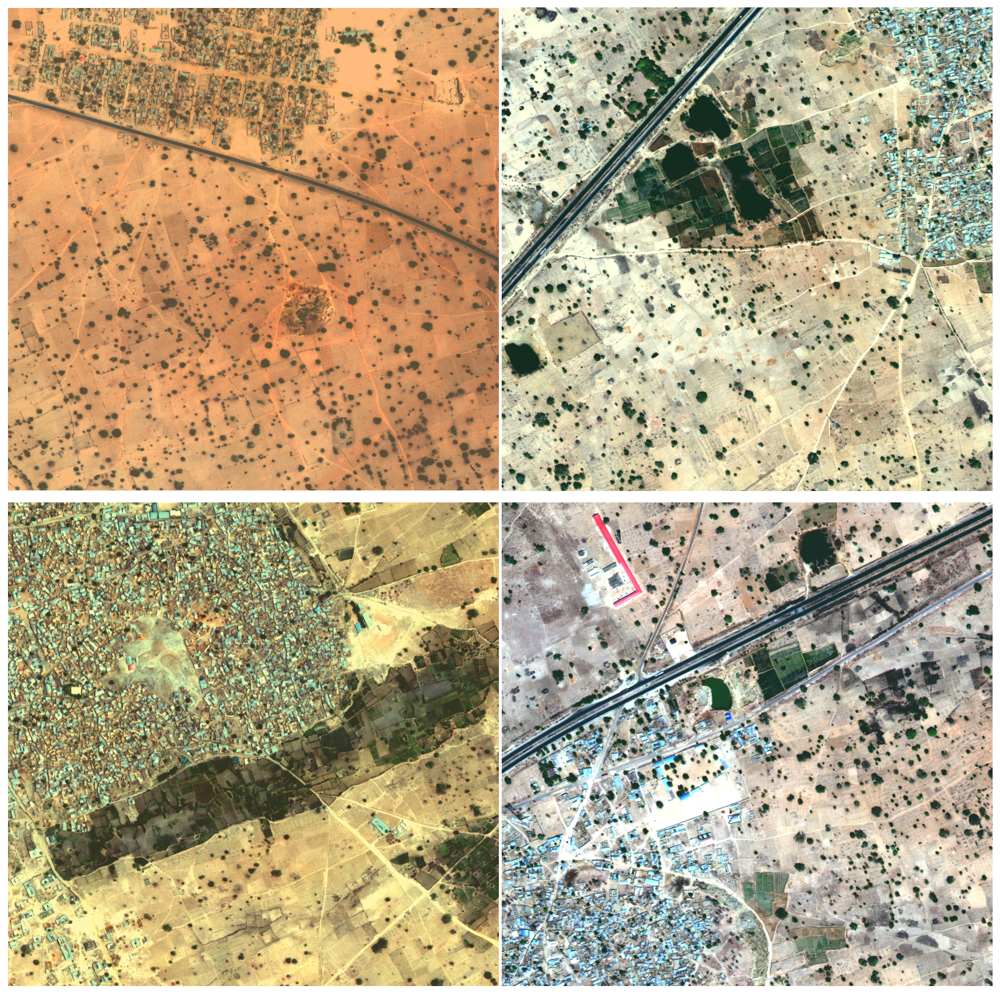

In [0]:
show_images()

In [0]:
def show_image_with_mask(imageId, maskAlpha=0.4, figsize=(10, 10)):
    fig, ax = plt.subplots(figsize=figsize)

    img = stretch_n(M(imageId))
    mask = generate_mask_for_image_and_class(img.shape[:2], imageId)
    
    tifffile.imshow(img, figure=fig, subplot=ax)
    ax.imshow(mask, alpha=maskAlpha)
    ax.axis("off")
    plt.show()

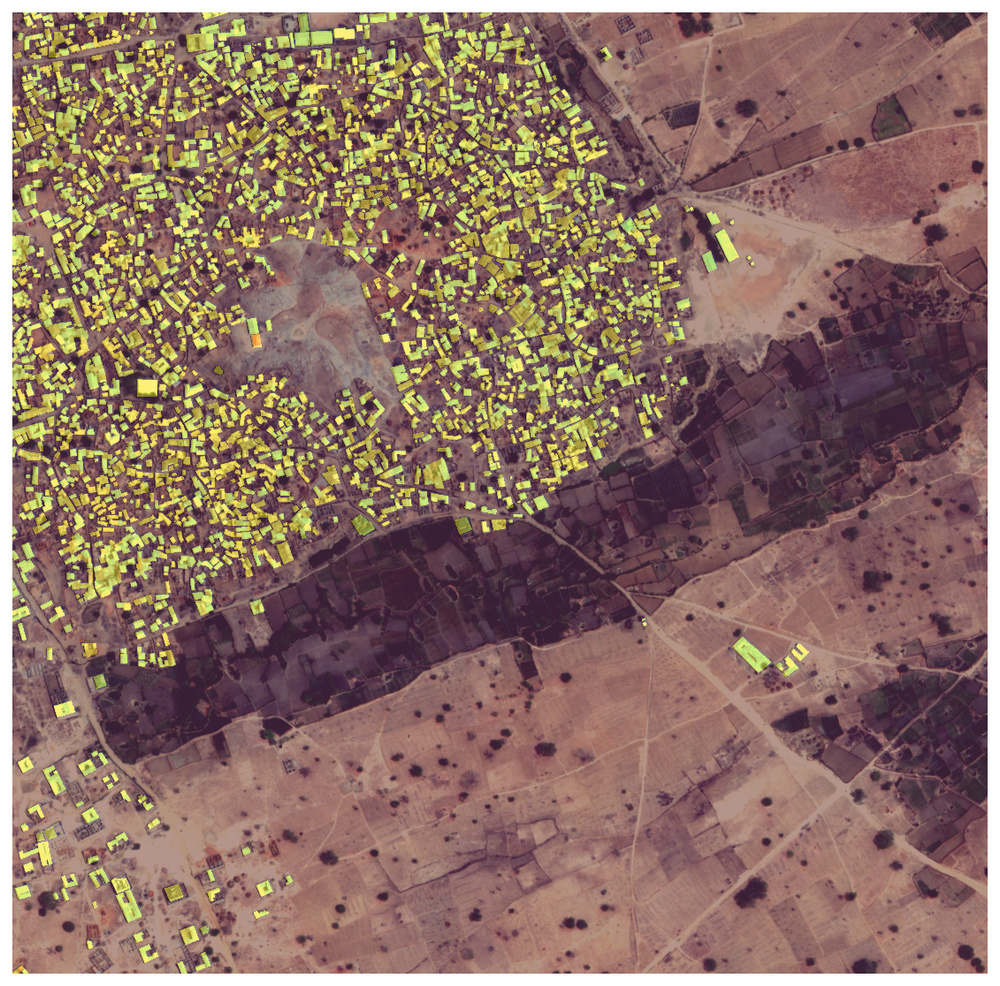

In [0]:
show_image_with_mask(df_train_buildings.iloc[2].ImageId)

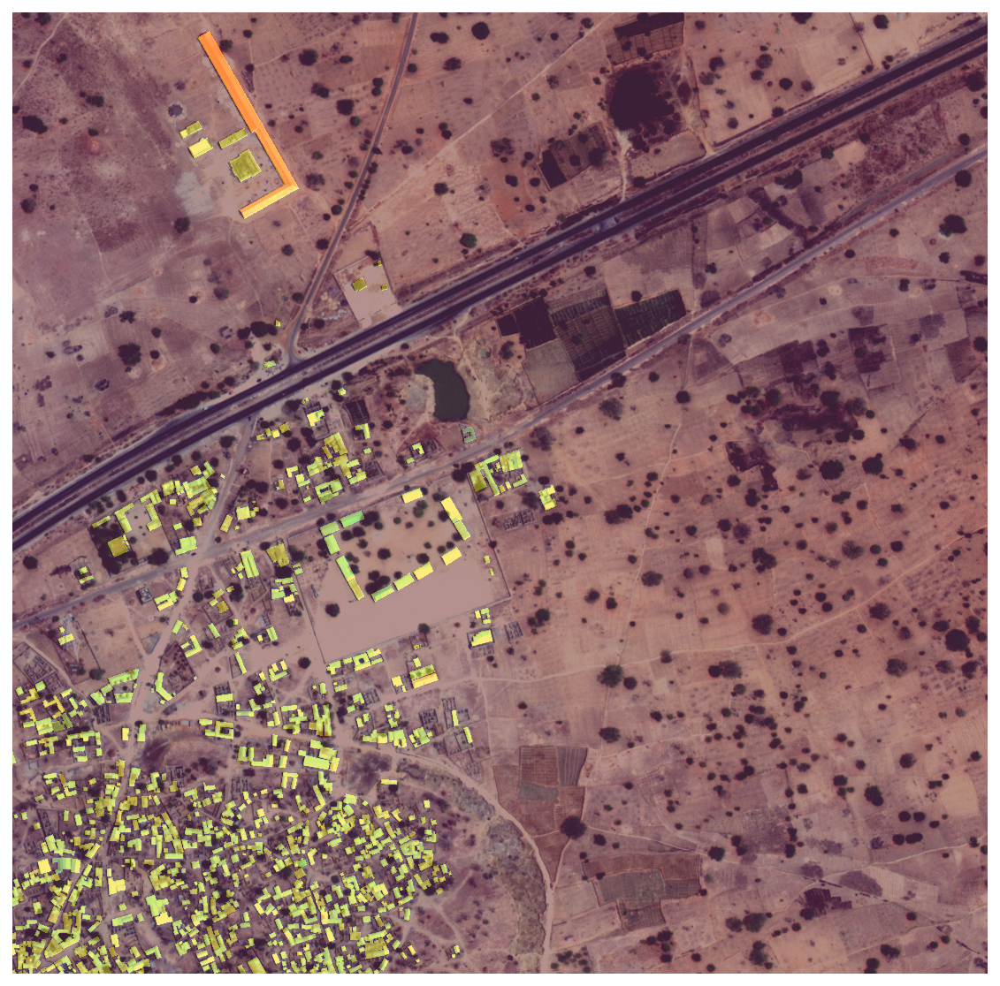

In [0]:
show_image_with_mask(df_val_buildings.iloc[0].ImageId)

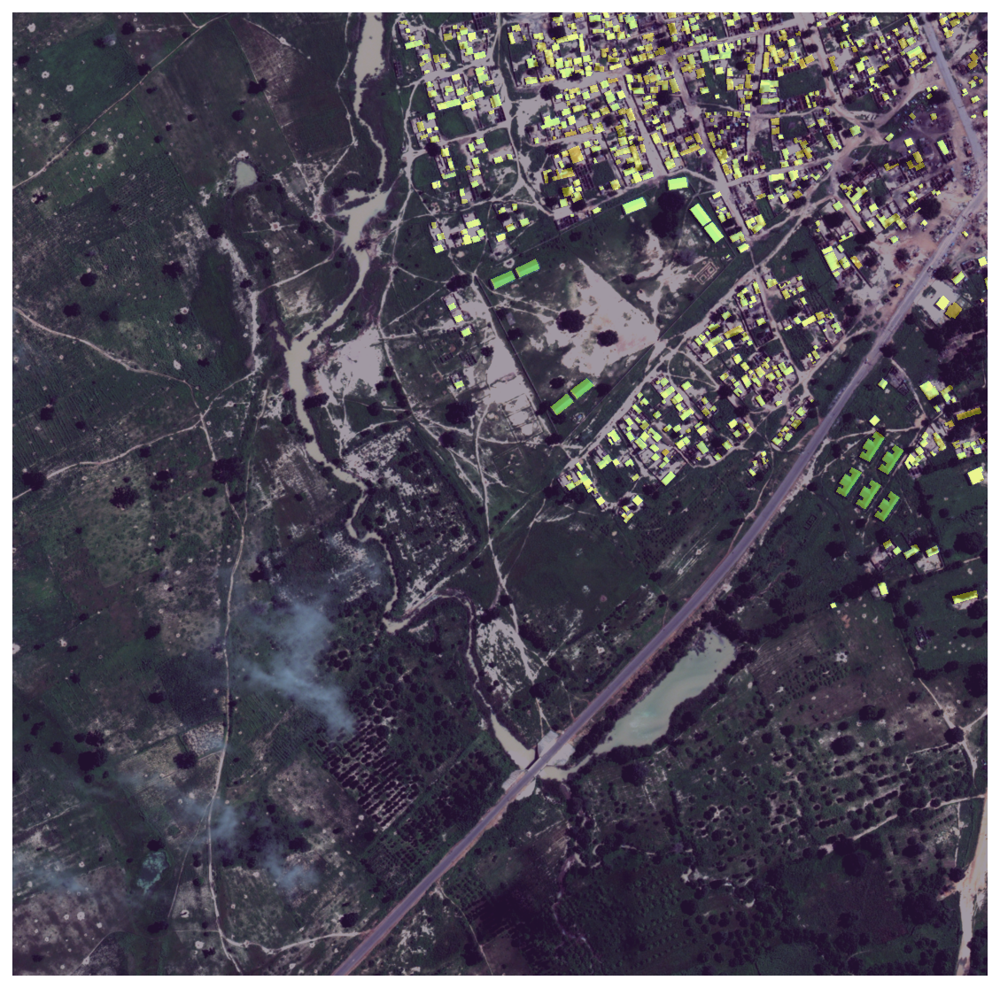

In [0]:
show_image_with_mask(df_val_buildings.iloc[1].ImageId)

## Preprocessing

In [43]:
df_train_val_buildings.shape

(25, 11)

In [44]:
!ls "{rootDir.resolve()}"

grid_sizes.csv.zip	   sixteen_band  train_geojson_v3.zip
sample_submission.csv.zip  three_band	 train_wkt_v4.csv.zip


In [0]:
trainValPreprocessedDir = rootDir / "preprocessed"

if not trainValPreprocessedDir.exists():
    trainValPreprocessedDir.mkdir()

In [0]:
def stack(band_paths, out_path):
    """Stack a set of bands into a single file.
    Based on: https://github.com/mapbox/rasterio/issues/1273#issue-295230001

    Parameters
    ----------
    band_paths : list of file paths
        A list with paths to the bands you wish to stack. Bands
        will be stacked in the order given in this list.
    out_path : string
        A path for the output file.
    """
    first_band = rasterio.open(band_paths[0], 'r')
    meta = first_band.meta.copy()

    counts = 0
    for ifile in band_paths:
        first_band = rasterio.open(band_paths[0], 'r')
        with rasterio.open(ifile, 'r') as ff:
            counts += ff.meta['count']
    meta.update(count=counts)

    band_start_index = 1

    with rasterio.open(out_path, 'w', **meta) as ff:
        for img_path in band_paths:
            with rasterio.open(img_path, 'r') as band_set:
                read_band_idx = range(1, 1 + band_set.count)
                bands = band_set.read(read_band_idx, 
                                      out_shape=(band_set.count, meta["height"], meta["width"]), 
                                      resampling=Resampling.bilinear)
                if bands.ndim != 3:
                    bands = bands[np.newaxis, ...] 
                write_band_idx = range(band_start_index, band_start_index + band_set.count)
                ff.write(bands, write_band_idx)
                band_start_index += band_set.count

In [0]:
def preprocess_images(imageIds=df_train_val_buildings.ImageId, dst=trainValPreprocessedDir):
    for imageId in tqdm(imageIds, leave=False):
        band_paths = [threeBandImagesDir / f"{imageId}.tif", 
                      #sixteenBandImagesDir / f"{imageId}_M.tif", 
                      #sixteenBandImagesDir / f"{imageId}_P.tif"
                      ]
        stack(band_paths=band_paths, out_path=dst / f"{imageId}.tif")

def calculate_channel_means_and_stds(imageIds=df_train_buildings.ImageId, img_dir=trainValPreprocessedDir, on_normalized=True):
    scaler = StandardScaler()

    for imageId in tqdm(imageIds, leave=False):
        with rasterio.open(img_dir / f"{imageId}.tif", 'r') as img:
            img_np = img.read(range(1, img.count + 1))
            if on_normalized:
                img_np = img_np / 2047
            img_np = np.array([img_np[i, :, :].ravel() for i in range(img_np.shape[0])]).transpose()
            scaler.partial_fit(img_np)
    
    return scaler.mean_, scaler.scale_

In [48]:
%%time
preprocess_images()

/usr/local/lib/python3.6/dist-packages/rasterio/__init__.py:219: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.6/dist-packages/rasterio/__init__.py:229: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  **kwargs)


CPU times: user 2.35 s, sys: 2.97 s, total: 5.32 s
Wall time: 11.6 s


In [49]:
!ls "{trainValPreprocessedDir.resolve()}"

6010_1_2.tif  6040_2_2.tif  6100_1_3.tif  6110_4_0.tif	6150_2_3.tif
6010_4_2.tif  6040_4_4.tif  6100_2_2.tif  6120_2_0.tif	6160_2_1.tif
6010_4_4.tif  6060_2_3.tif  6100_2_3.tif  6120_2_2.tif	6170_0_4.tif
6040_1_0.tif  6070_2_3.tif  6110_1_2.tif  6140_1_2.tif	6170_2_4.tif
6040_1_3.tif  6090_2_0.tif  6110_3_1.tif  6140_3_1.tif	6170_4_1.tif


In [50]:
%%time
mean, std = calculate_channel_means_and_stds()

CPU times: user 3.48 s, sys: 957 ms, total: 4.44 s
Wall time: 4.45 s


In [0]:
class Cropper:
    def __init__(self, crop_height=300, crop_width=300, n_crops=None):
        """ Creates a cropper.

        Parameters
        ----------
        crop_height : integer
            The height of the crop.
        crop_width : string
            The width of the crop.
        n_crops (optional, default=None) : integer
            If n_crops=None then the maximum number of rectangles of size 
            (crop_width, crop_height) will be cut from an image as uniformly as
            possible. If n_crops is an integer then n_crops
            randomly positioned rectangles of size 
            (crop_width, crop_height) will be cut from an image.
        """
        self.crop_height = crop_height
        self.crop_width = crop_width
        self.n_crops = n_crops
        self.imageIdToNCropsMap = {}

    def crop(self, imageId, img_root_dir, imgSaveDir, maskSaveDir):
        img_path = img_root_dir / f"{imageId}.tif"

        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            with rasterio.open(img_path) as img:
                img_height, img_width = img.shape
                mask = generate_mask_for_image_and_class(img.shape, imageId)

                crop_shapes = self.create_crop_rectangles(img_width, img_height)
                self.imageIdToNCropsMap[imageId] = len(crop_shapes)

                for i, crop_rectangle in enumerate(crop_shapes):
                    filename = f"{imageId}_{i}"
                    self._save_cropped_image(img, crop_rectangle, 
                                            imgSaveDir / f"{filename}.tif")
                    self._save_cropped_mask(mask, crop_rectangle, 
                                            maskSaveDir / f"{filename}.png")


    def crop_all(self, imageIds, img_root_dir, imgSaveDir, maskSaveDir):
        for imageId in tqdm(imageIds, desc="Cropping images", position=0, leave=False):
            self.crop(imageId, img_root_dir, imgSaveDir, maskSaveDir)

    def create_crop_rectangles(self, img_width, img_height):
        if self.n_crops is not None:
            return self._create_random_crop_rectangles(img_width, img_height)
        return self._create_equidistant_crop_rectangles(img_width, img_height)

    def n_total_created_crops(self):
        return int(np.sum(list(self.imageIdToNCropsMap.values())))

    def _create_random_crop_rectangles(self, img_width, img_height):
        g = GeoSeries([])

        for i in range(self.n_crops):
            while(True):
                crop_x = random.randint(0, img_width - self.crop_width)
                crop_y = random.randint(0, img_height - self.crop_height)
                polygon = self._create_rectangle(crop_x, crop_y, 
                                                    self.crop_width, 
                                                    self.crop_height)
                
                if not any(g.intersects(polygon)):
                    break
            g = g.append(GeoSeries([polygon]))
        return g

    def _create_equidistant_crop_rectangles(self, img_width, img_height):
        n_crops_per_row = img_width // self.crop_width
        n_crops_per_col = img_height // self.crop_height

        remaining_x_space = img_width % self.crop_width
        remaining_y_space = img_height % self.crop_height

        x_spacings = np.zeros(n_crops_per_row)
        x_spacings[1:] = remaining_x_space // (n_crops_per_row - 1)

        if remaining_x_space % (n_crops_per_row - 1) != 0:
            x_spacings[-1] += remaining_x_space % (n_crops_per_row - 1)

        y_spacings =  np.zeros(n_crops_per_col)
        y_spacings[1:] = remaining_y_space // (n_crops_per_col - 1)

        if remaining_y_space % (n_crops_per_col - 1) != 0:
            y_spacings[-1] += remaining_y_space % (n_crops_per_col - 1)

        polygons = []
        
        for i in range(n_crops_per_col):
            for j in range(n_crops_per_row):
                crop_x = j * self.crop_width + np.sum(x_spacings[:j+1])
                crop_y = i * self.crop_height + np.sum(y_spacings[:i+1])

                polygon = self._create_rectangle(crop_x, crop_y, 
                                                 self.crop_width, 
                                                 self.crop_height)
                polygons.append(polygon)

        return GeoSeries(polygons)

    @staticmethod
    def _create_rectangle(x, y, w, h):
        return Polygon([(x, y), (x, y + h), (x + w, y + h), (x + w, y)])

    @staticmethod
    def _save_cropped_mask(mask, crop_rectangle, path):
        xmin, ymin, xmax, ymax = (int(coord) for coord in crop_rectangle.bounds)
        crop_mask = mask[ymin:ymax, xmin:xmax]
        crop_mask_img = Image.fromarray(crop_mask)
        crop_mask_img.save(path)

    @staticmethod
    def _save_cropped_image(img, crop_rectangle, path):
        crop_img, _ = rasterio.mask.mask(img, [crop_rectangle], crop=True)
        with rasterio.open(path, 'w', driver='GTiff', width=crop_img.shape[2], 
            height=crop_img.shape[1], count=crop_img.shape[0],
            dtype=crop_img.dtype) as img_file:
            img_file.write(crop_img)

In [0]:
# Create folders to hold the cropped images for the training and validation sets.
croppedImgDir = rootDir / "cropped_imgs"
croppedMaskDir = rootDir / "cropped_masks"

trainCroppedImgDir = croppedImgDir / "training_set"
trainCroppedMaskDir = croppedMaskDir / "training_set"

validationCroppedImgDir = croppedImgDir / "validation_set"
validationCroppedMaskDir = croppedMaskDir / "validation_set"

for directory in [croppedImgDir, croppedMaskDir, trainCroppedImgDir, 
                  trainCroppedMaskDir, validationCroppedImgDir, 
                  validationCroppedMaskDir]:
    if not directory.exists():
        directory.mkdir()

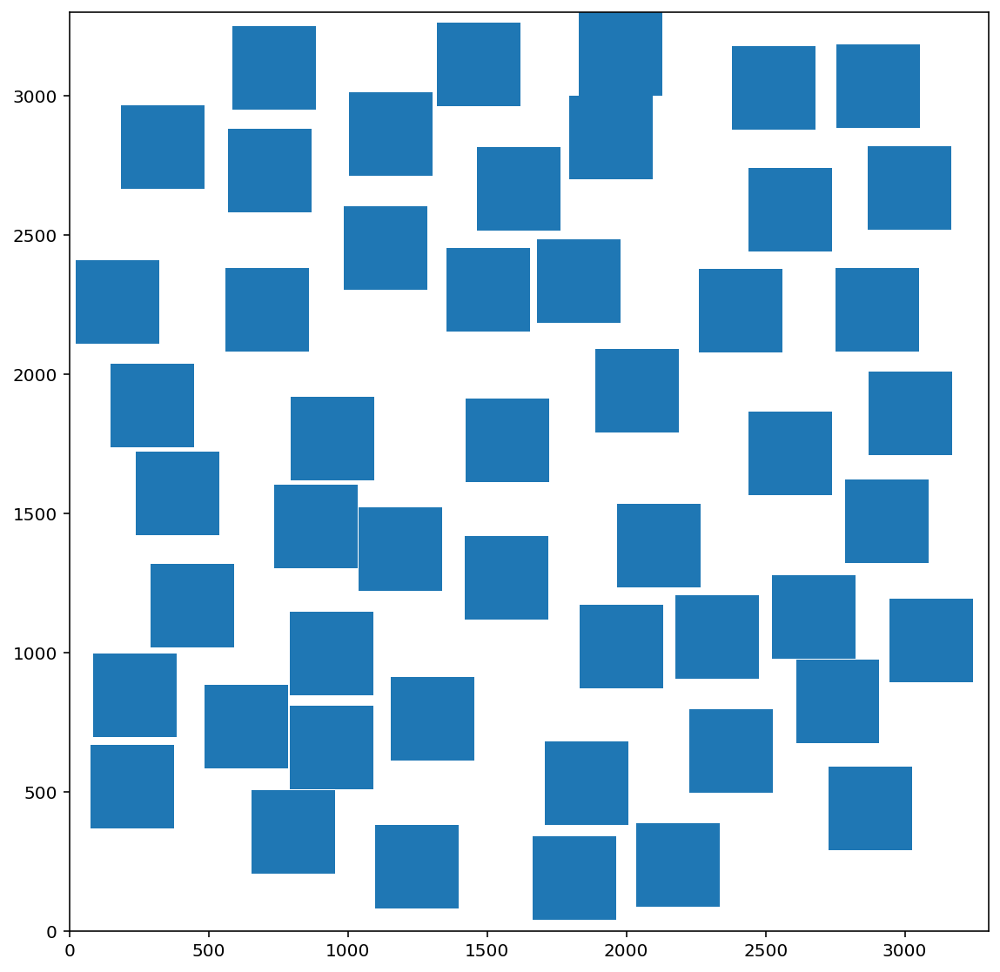

In [53]:
# Training crops will have a size of (300, 300) and be randomly cut from the source images.
training_cropper = Cropper(crop_height=300, crop_width=300, n_crops=50)

# Example visualisation:
training_cropper.create_crop_rectangles(3300, 3300).plot(figsize=(8,8))
plt.axis([0, 3300, 0, 3300])
plt.tight_layout()

In [54]:
# Create training crops:
%%time
training_cropper.crop_all(df_train_buildings.ImageId, trainValPreprocessedDir,  
                          trainCroppedImgDir, trainCroppedMaskDir)

CPU times: user 2.9 s, sys: 304 ms, total: 3.2 s
Wall time: 3.26 s


In [55]:
# Check if image and mask crop-files were created:
print("Image crops")
!ls "{trainCroppedImgDir.resolve()}" | wc -l
!ls "{trainCroppedImgDir.resolve()}" | head -5

print("\nMask crops")
!ls "{trainCroppedMaskDir.resolve()}" | wc -l
!ls "{trainCroppedMaskDir.resolve()}" | head -5

Image crops
250
6070_2_3_0.tif
6070_2_3_10.tif
6070_2_3_11.tif
6070_2_3_12.tif
6070_2_3_13.tif

Mask crops
250
6070_2_3_0.png
6070_2_3_10.png
6070_2_3_11.png
6070_2_3_12.png
6070_2_3_13.png


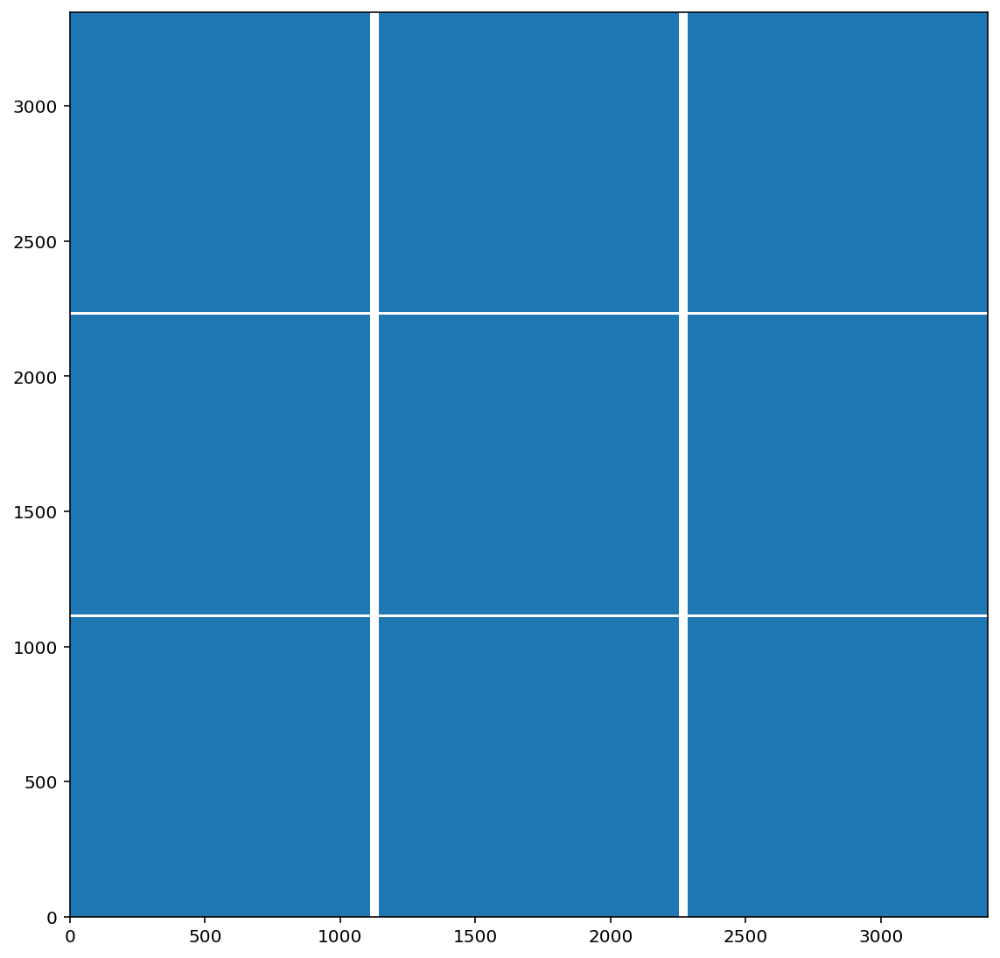

In [56]:
# Define validation cropper, here we do not use random crops. 
validation_cropper = Cropper(crop_height=1110, crop_width=1110)

# Example visualisation:
validation_cropper.create_crop_rectangles(df_val_buildings.iloc[0].width, df_val_buildings.iloc[0].height).plot(figsize=(8,8))
plt.axis([0, df_val_buildings.iloc[0].width, 0, df_val_buildings.iloc[0].height])
plt.tight_layout()

In [57]:
# Create validation crops
validation_cropper.crop_all(df_val_buildings.ImageId, trainValPreprocessedDir, validationCroppedImgDir, validationCroppedMaskDir)

In [58]:
# Check if image and mask crop-files were created:
print("Image crops")
!ls "{validationCroppedImgDir.resolve()}" | wc -l
!ls "{validationCroppedImgDir.resolve()}" | head -5

print("\nMask crops")
!ls "{validationCroppedMaskDir.resolve()}" | wc -l
!ls "{validationCroppedMaskDir.resolve()}" | head -5

Image crops
18
6100_2_2_0.tif
6100_2_2_1.tif
6100_2_2_2.tif
6100_2_2_3.tif
6100_2_2_4.tif

Mask crops
18
6100_2_2_0.png
6100_2_2_1.png
6100_2_2_2.png
6100_2_2_3.png
6100_2_2_4.png


In [0]:
def show_crop_with_mask(imageId, cropId, imgCropDir=trainCroppedImgDir, 
                        maskCropDir=trainCroppedMaskDir, fig=None, ax=None):
    do_show = False

    if fig is None or ax is None:
        fig, ax = plt.subplots(figsize=(8,8))
        do_show = True

    img_filepath = os.path.join(imgCropDir, f"{imageId}_{cropId}.tif")
    
    img = tifffile.imread(img_filepath)[:, :, :3]

    img = stretch_n(img)

    mask_filepath = maskCropDir / f"{imageId}_{cropId}.png"
    mask_img = Image.open(mask_filepath)

    tifffile.imshow(img, figure=fig, subplot=ax)
    ax.imshow(mask_img, alpha=0.5)
    ax.axis("off")

    if do_show:
        plt.show()

def show_random_crop_with_mask_grid(df=df_train_buildings, ncols=3, nrows=3, 
                                    imgCropDir=trainCroppedImgDir, 
                                    maskCropDir=trainCroppedMaskDir, 
                                    figsize=(10,10)):
    fig, ax = plt.subplots(ncols=ncols, nrows=nrows, figsize=figsize)
    imageIds = df.sample(nrows).ImageId.tolist()
    ncrops = len(list(imgCropDir.iterdir())) // len(df)
    cropIds = np.random.choice(range(ncrops), size=ncols, replace=False)

    for i in range(nrows):
        for j in range(ncols):
            show_crop_with_mask(imageIds[i], cropIds[j], imgCropDir, maskCropDir,
                                fig=fig, ax=ax[i,j])
    plt.tight_layout(pad=0, h_pad=0.1, w_pad=0.1)
    plt.show()

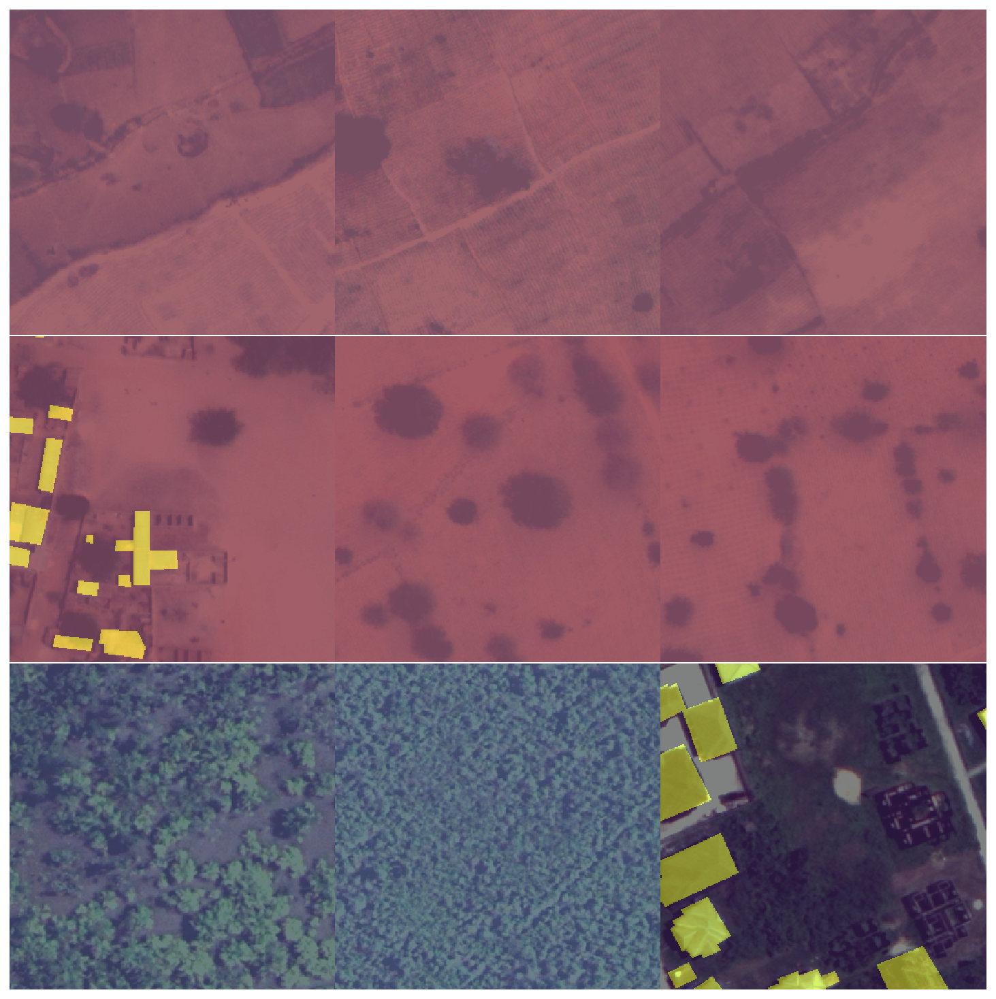

In [59]:
show_random_crop_with_mask_grid()

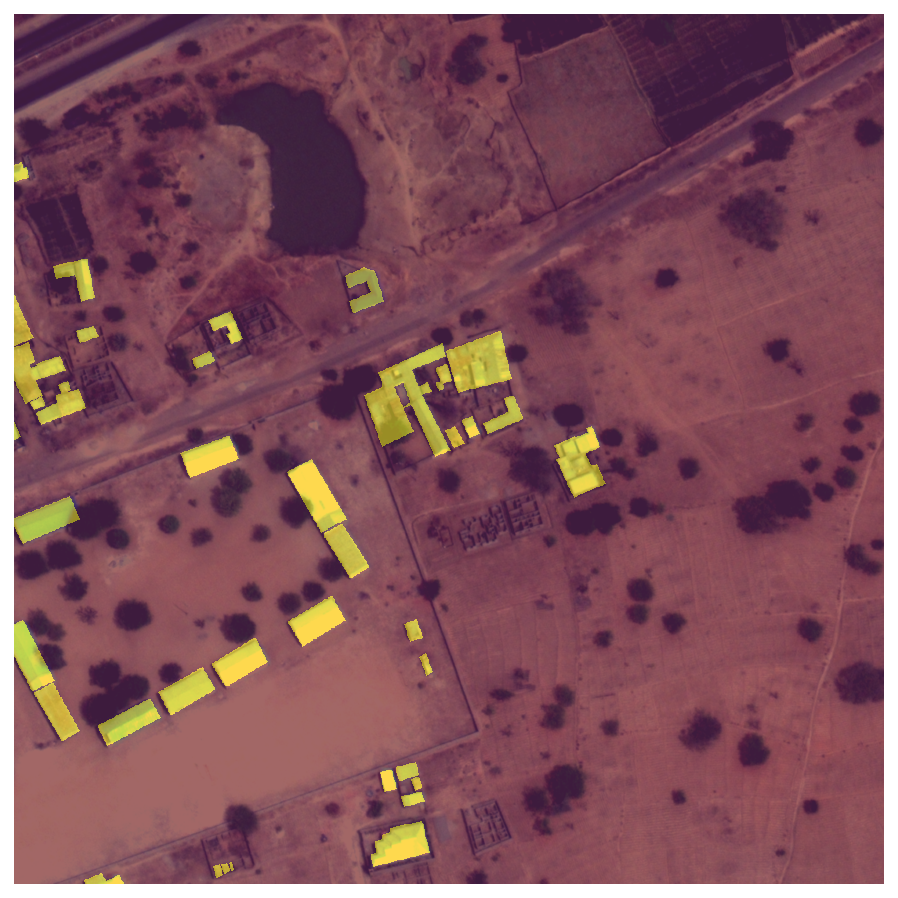

In [60]:
show_crop_with_mask(df_val_buildings.iloc[0].ImageId, 4, 
                    imgCropDir=validationCroppedImgDir, 
                    maskCropDir=validationCroppedMaskDir)

## Training

In [0]:
class SatelliteDataset(Dataset):
    def __init__(self, imgDir, maskDir, transform=None):
        super(SatelliteDataset, self).__init__()
        self.imgDir = imgDir
        self.maskDir = maskDir
        self.transform = transform
        self.imageFiles = sorted([item for item in imgDir.iterdir() if item.is_file()])

    def __getitem__(self, index):
        img_path = self.imageFiles[index]
        mask_path = self.maskDir / f"{img_path.stem}.png"

        img = tifffile.imread(os.path.join(img_path))
        mask = Image.open(mask_path)

        if self.transform is not None:
            img, mask = self.transform(img, mask)

        return img, mask
        
    def show_untransformed_sample(self, index, maskAlpha=0.3, figsize=(8,8), rgb_channels=[0, 1, 2]):
        img_path = self.imageFiles[index]
        mask_path = self.maskDir / f"{img_path.stem}.png"

        img = stretch_n(tifffile.imread(os.path.join(img_path))[:,:,rgb_channels])
        mask = Image.open(mask_path)

        fig, ax = plt.subplots(figsize=figsize)
        tifffile.imshow(img, figure=fig, subplot=ax)
        ax.imshow(mask, alpha=maskAlpha)
        ax.axis("off")
        plt.show()

    def __len__(self):
        return len(self.imageFiles)

In [0]:
class ImgMaskTransformCompose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, img, mask):
        for t in self.transforms:
            img, mask = t(img, mask)
        return img, mask

class ImgMaskMinMaxScaler:
    def __init__(self, img_mins, img_maxs):
        self.img_mins = img_mins
        self.img_maxs = img_maxs

    def __call__(self, img, mask):
        return (img - self.img_mins) / (self.img_maxs - self.img_mins), mask

class ImgMaskTensorNormalize(torchvision.transforms.Normalize):
    def __call__(self, img, mask):
        return super(ImgMaskTensorNormalize, self).__call__(img), mask

class ImgMaskRandomHorizontalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, img, mask):
        if random.random() < self.p:
            img = np.fliplr(img)
            mask = mask.transpose(Image.FLIP_LEFT_RIGHT)
        return img, mask

class ImgMaskRandomVerticalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, img, mask):
        if random.random() < self.p:
            img = np.flipud(img)
            mask = mask.transpose(Image.FLIP_TOP_BOTTOM)
        return img, mask

class ImgMaskToTensor:
    def __call__(self, img, mask):
        return torchvision.transforms.functional.to_tensor(img.astype(np.float32)), torch.as_tensor(np.array(mask), dtype=torch.uint8)

In [0]:
# Trainings and validation transformations
tf_train = ImgMaskTransformCompose([
     ImgMaskMinMaxScaler(img_mins=0, img_maxs=2047),
     ImgMaskRandomHorizontalFlip(),
     ImgMaskRandomVerticalFlip(),
     ImgMaskToTensor(),
     ImgMaskTensorNormalize(mean=imagenet_means, std=imagenet_stds)
     ]
)

tf_valid = ImgMaskTransformCompose([
    ImgMaskMinMaxScaler(img_mins=0, img_maxs=2047),
    ImgMaskToTensor(),
    ImgMaskTensorNormalize(mean=imagenet_means, std=imagenet_stds)
    ]
)

ds_train = SatelliteDataset(trainCroppedImgDir, trainCroppedMaskDir, transform=tf_train)
ds_valid = SatelliteDataset(validationCroppedImgDir, validationCroppedMaskDir, transform=tf_valid)

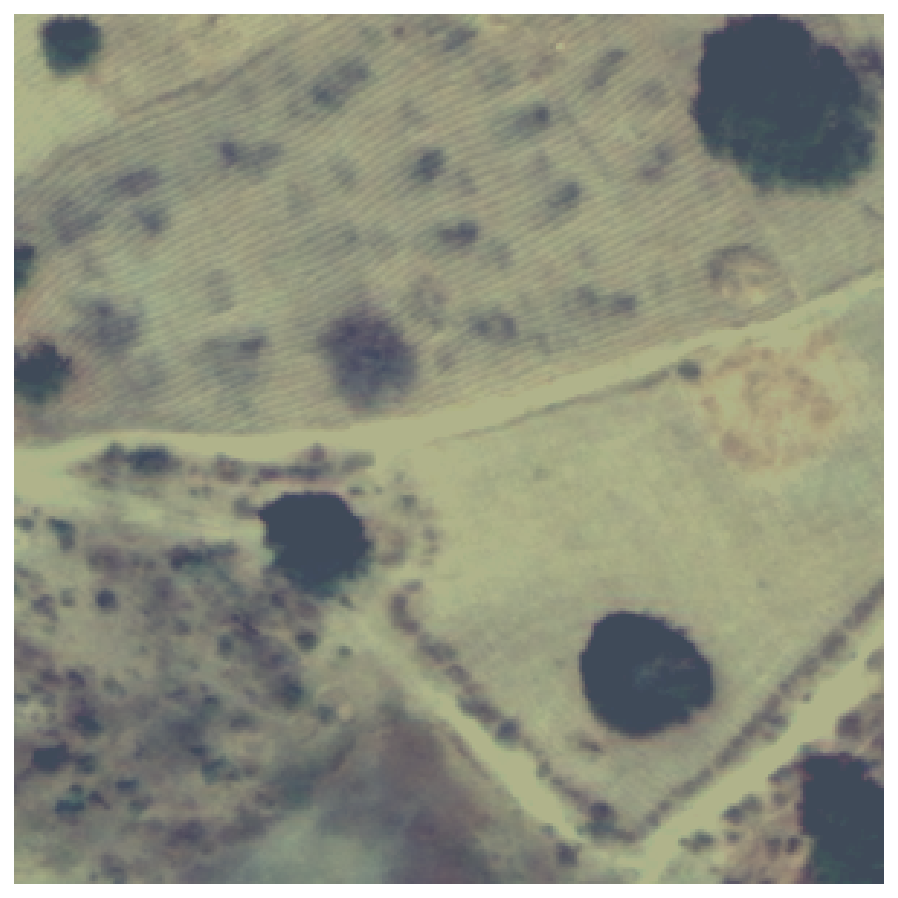

In [64]:
ds_train.show_untransformed_sample(111)

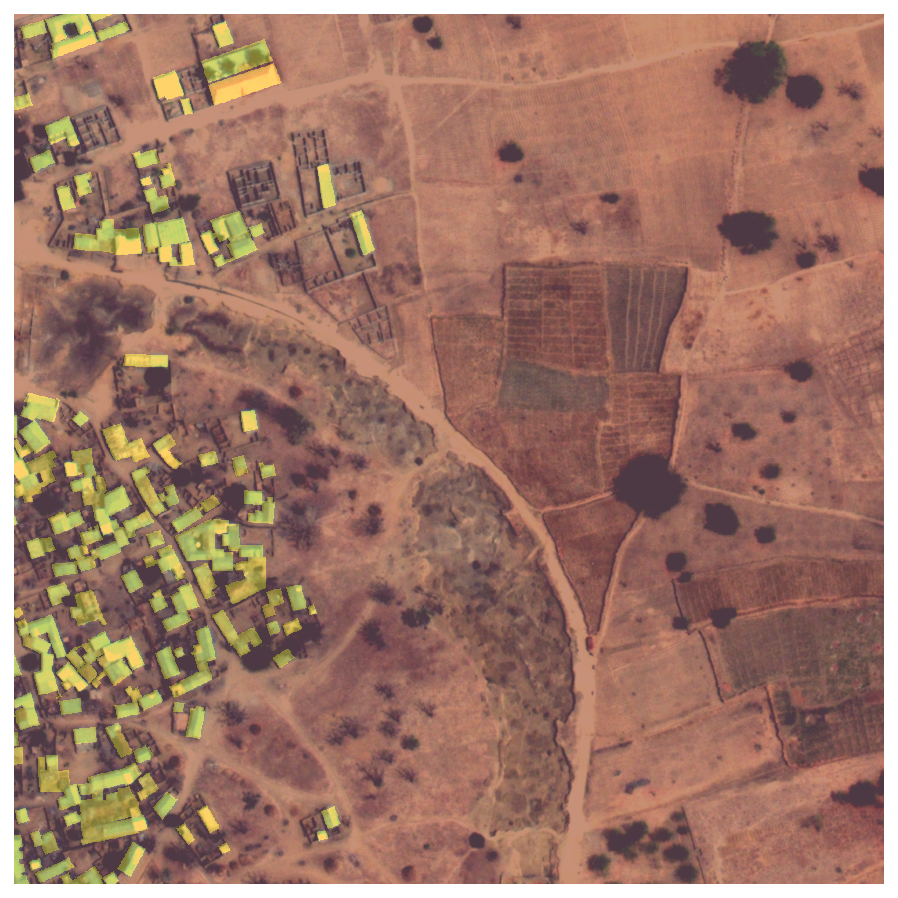

In [65]:
ds_valid.show_untransformed_sample(16)

### DataLoader

In [0]:
BATCH_SIZE = 24 
modelSaveDir = rootDir.parent / "models"

dl_train = DataLoader(ds_train, 
                      batch_size=BATCH_SIZE, 
                      shuffle=True,
                      num_workers=2)

dl_valid = DataLoader(ds_valid, 
                      batch_size=8,
                      num_workers=0)

In [157]:
# Check dimensions:
print("Training batch:")
img, mask = next(iter(dl_train))
print(img.shape)
print(mask.shape)
print("Validation batch:")
img, mask = next(iter(dl_valid))
print(img.shape)
print(mask.shape)

Training batch:
torch.Size([24, 3, 300, 300])
torch.Size([24, 300, 300])
Validation batch:
torch.Size([8, 3, 1110, 1110])
torch.Size([8, 1110, 1110])


## Model

In [0]:
class UNetDoubleConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, dropout, activation, padding=1):
        super(UNetDoubleConvBlock, self).__init__();
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 
                      padding=padding, bias=False),
            nn.BatchNorm2d(out_channels),
            activation,
            nn.Dropout2d(p=dropout),
            nn.Conv2d(out_channels, out_channels, 3, 
                      padding=padding, bias=False),
            nn.BatchNorm2d(out_channels),
            activation,
            nn.Dropout2d(p=dropout)
        )
        
    def forward(self, X):
        return self.conv(X)

class UNetExpansionBlock(nn.Module):
    def __init__(self, in_size, out_size, dropout, activation, padding=1, use_recurrent_block=False):
        super(UNetExpansionBlock, self).__init__()
        if use_recurrent_block:
            self.conv = UNetRRCNNBlock(in_size, out_size, dropout=dropout, padding=padding)
        else:
            self.conv = UNetDoubleConvBlock(in_size, out_size, dropout, activation, padding)

        self.upconv = nn.ConvTranspose2d(out_size, out_size, 
                                         kernel_size=2, stride=2)
        self.relu = activation
    
    def forward(self, X_up, X_down):
        X = torch.cat((X_up, X_down), 1)
        X = self.conv(X)
        X = self.upconv(X)
        X = self.relu(X)
        return X

class UNetAttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(UNetAttentionBlock, self).__init__()

        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, bias=False),
            nn.BatchNorm2d(F_int)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, bias=False),
            nn.BatchNorm2d(F_int)
        )

        self.Psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        W_g_out = self.W_g(g)
        W_x_out = self.W_x(x)

        out = self.relu(W_g_out + W_x_out)
        out = self.Psi(out)

        return x*out

class UNetRecurrentBlock(nn.Module):
    def __init__(self, n_channels, dropout, rec_depth=3, padding=1):
        super(UNetRecurrentBlock, self).__init__()
        self.rec_depth = rec_depth
        self.conv = nn.Sequential(
            nn.Conv2d(n_channels, n_channels, kernel_size=3, padding=padding),
            nn.BatchNorm2d(n_channels),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout)
        )

    def forward(self, X):
        X_next = self.conv(X)

        for i in range(self.rec_depth - 1):
            X_next = self.conv(X + X_next)

        return X_next

class UNetRRCNNBlock(nn.Module):
    def __init__(self, in_size, out_size, dropout, rec_depth=3, padding=1):
        super(UNetRRCNNBlock, self).__init__()
        self.in_conv = nn.Conv2d(in_size, out_size, kernel_size=1)
        self.rec_conv = nn.Sequential(
            UNetRecurrentBlock(out_size, dropout, rec_depth, padding=padding),
            UNetRecurrentBlock(out_size, dropout, rec_depth, padding=padding)
        )

    def forward(self, X):
        X = self.in_conv(X)
        X_next = self.rec_conv(X)

        return X + X_next

class UNet(nn.Module):
    # Basiert auf:
    # https://arxiv.org/abs/1505.04597 (UNet Paper)
    # https://stackoverflow.com/questions/52235520/how-to-use-pnasnet5-as-encoder-in-unet-in-pytorch
    # https://github.com/jaxony/unet-pytorch/blob/master/model.py
    def __init__(self, n_classes=1,
                 input_channels=3, 
                 adaptiveInputPadding=True, 
                 pretrained_encoder=True, 
                 freeze_encoder=True,
                 activation=nn.ReLU(inplace=True),
                 dropout=0.2,
                 use_hypercolumns=False,
                 use_attention=False,
                 use_recurrent_decoder_blocks=False):
        super(UNet, self).__init__()
        self.input_channels = input_channels
        encoder_backbone = torchvision.models.resnet34(pretrained=pretrained_encoder)
        encoder_backbone.relu = activation
        self.n_classes = n_classes
        self.adaptiveInputPadding = adaptiveInputPadding
        self.use_hypercolumns = use_hypercolumns
        self.use_attention = use_attention

        d1 = []

        if self.input_channels != 3:
            if pretrained_encoder:
                d1.extend([nn.Conv2d(self.input_channels, 3, 1, bias=False), nn.BatchNorm2d(3)])
            else:
                encoder_backbone.conv1 = nn.Conv2d(self.input_channels, 
                                                   encoder_backbone.conv1.out_channels, 
                                                   kernel_size=7, stride=2, padding=3, bias=False)

        
        d1.extend([encoder_backbone.conv1, 
                   encoder_backbone.bn1, 
                   encoder_backbone.relu, 
                   encoder_backbone.layer1])
        d1 = nn.Sequential(*d1)
        d2 = encoder_backbone.layer2 
        d3 = encoder_backbone.layer3 
        d4 = encoder_backbone.layer4 

        self.encoder = nn.ModuleList([d1, d2, d3, d4])
        self.input_size_reduction_factor = 2 ** len(self.encoder) 

        bottom_channel_nr = self._calculate_bottom_channel_number() 

        self.center = UNetDoubleConvBlock(bottom_channel_nr, 
                                          bottom_channel_nr, 
                                          dropout, activation)

        if self.use_hypercolumns:
            self.hyper_col_convs = nn.ModuleList([nn.Conv2d(bottom_channel_nr, out_channels=3, kernel_size=3, padding=1)])

        if self.use_attention:
            self.attention_layers = nn.ModuleList([])

        layer_in = bottom_channel_nr * 2
        layer_out = bottom_channel_nr // 2

        self.decoder = nn.ModuleList([])

        for i in range(len(self.encoder)):
            if self.use_attention:
                self.attention_layers.append(UNetAttentionBlock(layer_in // 2, layer_in // 2, layer_in // 2))

            self.decoder.append(UNetExpansionBlock(layer_in, layer_out, dropout, activation, 
                                                   use_recurrent_block=use_recurrent_decoder_blocks))

            if i != len(self.encoder) - 1:
                if self.use_hypercolumns:
                    self.hyper_col_convs.append(nn.Conv2d(layer_out, out_channels=3, kernel_size=3, padding=1))
                layer_in //= 2
                layer_out //= 2
            

        hyper_col_num_channels = len(self.hyper_col_convs) * 3 if self.use_hypercolumns else 0

        self.out_conv = nn.Conv2d(layer_out + hyper_col_num_channels, n_classes, 1)

        if freeze_encoder:
            self.freeze_encoder()

    def forward(self, X):
        d_outputs = []

        if self.adaptiveInputPadding:
            X, padding_lr, padding_tb = self._adaptive_padding(X)

        for d in self.encoder:
            X = d(X)
            d_outputs.append(X)

        if self.use_hypercolumns:
            u_outputs = []

        X = self.center(X)

        for i, (u, d_out) in enumerate(zip(self.decoder, reversed(d_outputs))):
            if self.use_hypercolumns:
                hyper_col_output = F.interpolate(self.hyper_col_convs[i](X), 
                                                scale_factor=2**(len(self.decoder) - i), 
                                                mode="bilinear",
                                                align_corners=False)
                u_outputs.append(hyper_col_output)

            if self.use_attention:
                d_out = self.attention_layers[i](d_out, X)

            X = u(X, d_out)

        if self.use_hypercolumns:
            u_outputs.append(X)
            X = torch.cat(u_outputs, 1)

        X = self.out_conv(X)

        if self.adaptiveInputPadding:
            if padding_lr != (0,0) or padding_tb != (0,0):
                X = self._center_crop(X, padding_lr, padding_tb)

        return X

    def freeze_encoder(self, last_layer_to_freeze=None):
        if last_layer_to_freeze is None:
            last_layer_to_freeze = len(self.encoder) - 1

        for layer_index in range(last_layer_to_freeze + 1):
            for child in self.encoder[layer_index]:
                for parameter in child.parameters():
                    parameter.requires_grad = False

    def unfreeze_encoder(self, first_layer_to_unfreeze=None):
        if first_layer_to_unfreeze is None:
            first_layer_to_unfreeze = 0
        
        for layer_index in range(first_layer_to_unfreeze, len(self.encoder)):
            for child in self.encoder[layer_index]:
                for parameter in child.parameters():
                    parameter.requires_grad = True

    def encoder_freeze_status(self):
        frozen_status = [all([all([not param.requires_grad for param in child.parameters()]) 
                         for child in layer.children()]) for layer in self.encoder]

        return ["frozen" if status else "unfrozen" for status in frozen_status]

    def _adaptive_padding(self, X):
        X_height, X_width = X.shape[2:4]

        if X_width % self.input_size_reduction_factor != 0 or X_height % self.input_size_reduction_factor != 0:
            required_padding_left_right =  self._calculate_required_adaptive_padding(X_width)
            required_padding_top_bottom = self._calculate_required_adaptive_padding(X_height)

            X = nn.ReflectionPad2d(required_padding_left_right + required_padding_top_bottom)(X)
            return X, required_padding_left_right, required_padding_top_bottom

        return X, (0,0), (0,0)

    def _calculate_required_adaptive_padding(self, side_length):
        next_same_output_producing_size = self.input_size_reduction_factor * (side_length // self.input_size_reduction_factor  + 1)
        required_padding_space = next_same_output_producing_size - side_length

        required_padding = (required_padding_space // 2, required_padding_space // 2 + (required_padding_space % 2))

        return required_padding

    def _center_crop(self, X, lr_offset, tb_offset):
        X_height, X_width = X.shape[2:4]
        return X[:, :, tb_offset[0] : (X_height - tb_offset[1]), lr_offset[0] : (X_width - lr_offset[1])]

    def _calculate_bottom_channel_number(self):
        return [l for l in self.encoder[-1][-1].children() if isinstance(l, nn.Conv2d)][-1].out_channels

## Trainer

In [0]:
class Trainer:
    def __init__(self, model, dl_train, criterion, optimizer,
                 dl_valid=None, dl_test=None, device="cuda",
                 save_dir=None, metrics=None, on_train_val_epoch_finished_callback=None):
        self.model = model
        self.dl_train = dl_train
        self.num_train_samples = len(dl_train.dataset)
        self.criterion = criterion
        self.optimizer = optimizer
        self.dl_valid = dl_valid
        self.num_validation_samples = len(dl_valid.dataset)

        self.dl_test = dl_test
        self.device = device
        self.save_dir = save_dir
        self.metrics = metrics
        self.recorder = MetricRecorder(self.metrics)
        self.latest_lr_finder_result = None
        self.on_train_val_epoch_finished_callback = on_train_val_epoch_finished_callback

    def train(self, num_epochs, max_lr=1e-4, hide_progress=False):
        self.model.to(self.device)
        self.model.train()

        scheduler = torch.optim.lr_scheduler.OneCycleLR(self.optimizer, max_lr=max_lr,
                               steps_per_epoch=len(self.dl_train),
                               epochs=num_epochs)

        self.recorder.reset()

        for epoch in trange(num_epochs, desc="Epochs", disable=hide_progress):
            self._train_one_epoch(epoch, scheduler, hide_progress)

            if self.dl_valid is not None:
                self._validate(epoch, hide_progress)

            if self.on_train_val_epoch_finished_callback is not None:
                self.on_train_val_epoch_finished_callback(epoch)

        if self.device == "cuda":
            torch.cuda.empty_cache()

    def _train_one_epoch(self, epoch, scheduler, hide_progress):
        self.model.train()

        for img_batch, mask_batch in tqdm(self.dl_train, desc=f"Epoch {epoch}", leave=False,
                                          disable=hide_progress, position=0):

            img_batch, mask_batch = img_batch.to(self.device), mask_batch.to(self.device)

            self.optimizer.zero_grad()

            model_output = self.model(img_batch)

            loss = self.criterion(model_output, mask_batch)

            with torch.no_grad():
                self.recorder.update_record_on_batch_end(epoch, loss.item(), mask_batch, 
                                                         model_output.squeeze(), 
                                                         img_batch.size(0), 
                                                         self.num_train_samples)
            loss.backward()
            self.optimizer.step()
            scheduler.step()

        with torch.no_grad():
            self.recorder.finalize_record_on_epoch_end()

        tqdm.write(self.recorder.get_latest_epoch_message(training=True))

    def _validate(self, epoch,  hide_progress):
        assert self.dl_valid is not None
        self.model.eval()

        with torch.no_grad():
            for img_batch, mask_batch in tqdm(self.dl_valid, desc="Validating",
                                              disable=hide_progress, leave=False, position=0):
               
                img_batch, mask_batch = img_batch.to(self.device), mask_batch.to(self.device)
                model_output = self.model(img_batch)
                loss = self.criterion(model_output, mask_batch)

                self.recorder.update_record_on_batch_end(epoch, loss.item(), mask_batch, 
                                                         model_output.squeeze(), 
                                                         img_batch.size(0), 
                                                         self.num_validation_samples,
                                                         training=False)
            self.recorder.finalize_record_on_epoch_end(training=False)
            tqdm.write(self.recorder.get_latest_epoch_message(training=False))

    def lr_range_test(self, val_loss=False):
        lr_finder = LRFinder(self.model, self.optimizer, self.criterion, device=self.device)

        val_loader = self.dl_valid if val_loss else None

        lr_finder.range_test(self.dl_train, val_loader=val_loader, end_lr=100,
                             num_iter=100, step_mode="exp")

        lr_finder.plot()
        lr_finder.reset()
        self.latest_lr_finder_result = lr_finder

    def predict(self, image_input, threshold=0.5, image_preprocessing_cb=None):
        self.model.eval()

        if image_preprocessing_cb is not None:
            image_input = image_preprocessing_cb(image_input)

        with torch.no_grad():
            image_input = image_input.to(self.device)
            model_out = self.model(image_input)

        return model_out


class MetricRecorder:
    def __init__(self, metrics):
        self.data = {"training": [], "validation": []}
        self.metrics = metrics

    def reset(self):
        self.data = {"training": [], "validation": []}

        for metric in self.metrics:
            metric.reset()

    def update_record_on_batch_end(self, epoch, loss, actual, prediction, 
                                   n_batch_samples, n_total_samples, 
                                   threshold=0.5, training=True):
        records = self.data["training" if training else "validation"]

        if epoch >= len(records):
            record = defaultdict(float)
            record["epoch"] = epoch
            records.append(record)
        else:
            record = records[epoch]

        bs_ratio = n_batch_samples / n_total_samples

        record["loss"] += loss * bs_ratio

        if self.metrics is not None:
            pred_proba = (torch.sigmoid(prediction) > threshold).type(actual.dtype)
            for metric in self.metrics:
                metric.on_batch_end(actual, pred_proba, bs_ratio)

    def finalize_record_on_epoch_end(self, training=True):
        record = self.data["training" if training else "validation"][-1]

        metrics_dict = {}
        for metric in self.metrics:
            metrics_dict.update(metric.on_epoch_end())

        record.update(metrics_dict)


    def get_records_dataframe(self, training=True):
        return pd.DataFrame(self.data["training" if training else "validation"]).set_index("epoch")

    def get_latest_epoch_message(self, training=True):
        record_type = "Train" if training else "Valid"
        record = self.data["training" if training else "validation"][-1]

        message = "Epoch {0} - {1}: loss={2:.6f}".format(record["epoch"], record_type, record["loss"])
        metric_message = ', '.join(f"{key}={val:.4f}" for key, val in record.items() 
                                    if key is not "epoch" and key is not "loss")
        if metric_message:
            message += ", " + metric_message
        return message

    def show_train_val_metric_curve(self, metric="loss", figsize=(10, 8)):
        fig, ax = plt.subplots(figsize=figsize)

        train_pd = self.get_records_dataframe()
        val_pd = self.get_records_dataframe(training=False)

        train_pd.plot(y=metric, ax=ax, label=f"train-{metric}")
        val_pd.plot(y=metric, ax=ax, label=f"val-{metric}")
        plt.show()

In [160]:
# Calculate weight for building class
training_building_area_ratio = df_train_buildings.BuildingAreaRatio.mean()

building_class_weight = (1.0 - training_building_area_ratio) / training_building_area_ratio
building_class_weight

19.108223108182795

### Losses & Metrics

In [0]:
class DiceBCELoss(nn.Module):
    def __init__(self, bce_weight=0.3, bce_pos_weight=building_class_weight, dice_smooth=1):
        super(DiceBCELoss, self).__init__()
        self.bce_weight = bce_weight
        self.bce_pos_weight = bce_pos_weight 
        self.dice_smooth = dice_smooth

    def forward(self, inputs, targets):
        inputs = inputs.squeeze()
        prob_inputs = torch.sigmoid(inputs)
        targets = targets.type(torch.float32)
        
        intersection = (prob_inputs * targets).sum()                            
        dice_loss = 1 - (2.*intersection + self.dice_smooth)/(prob_inputs.sum() + targets.sum() + self.dice_smooth)  
        bce = F.binary_cross_entropy_with_logits(inputs, targets, reduction='mean', 
                                                 pos_weight=torch.tensor(self.bce_pos_weight))
        result =  self.bce_weight * bce + (1 -  self.bce_weight) * dice_loss
        
        return result

In [0]:
class MetricCallback:
    def on_batch_end(self, actual, prediction, bs_ratio):
        pass
    def on_epoch_end(self):
        pass

    def reset(self):
        pass

class AccuracyMetric(MetricCallback):
    name="acc"
    def __init__(self):
        self.reset()

    def reset(self):
        self.acc = torch.tensor(0.0)

    def on_batch_end(self, actual, prediction, bs_ratio):
        self.acc += (prediction == actual).float().mean() * bs_ratio

    def on_epoch_end(self):
        result = {self.name: self.acc.item()}
        self.reset()

        return result

class PrecisionRecallF1Metric(MetricCallback):
    def __init__(self):
        self.reset()

    def reset(self):
        self.tp = torch.tensor(0)
        self.tn = torch.tensor(0)
        self.fp = torch.tensor(0)
        self.fn = torch.tensor(0)

    def on_batch_end(self, actual, prediction, bs_ratio):
        self.tp += (actual * prediction).sum()
        self.tn += ((1 - actual) * (1 - prediction)).sum()
        self.fp += ((1 - actual) * prediction).sum()
        self.fn += (actual * (1 - prediction)).sum()

    def on_epoch_end(self):
        sum_tp_fp = self.tp + self.fp
        precision = self.tp.float() / sum_tp_fp.float() if sum_tp_fp is not 0 else 0

        sum_tp_fn = self.tp + self.fn
        recall = self.tp.float() / sum_tp_fn.float() if sum_tp_fn is not 0 else 0

        sum_precison_recall = precision + recall
        f1 = 2.0 * precision * recall / sum_precison_recall.float() if sum_precison_recall is not 0 else 0

        self.reset()

        return {"prec":precision.item(), "recall":recall.item(), "f1":f1.item()}

class IOUMetric(MetricCallback):
    def __init__(self, smooth=1e-6):
        self.smooth = smooth
        self.reset()

    def reset(self):
        self.intersection = torch.tensor(0)
        self.union = torch.tensor(0)

    def on_batch_end(self, actual, prediction, bs_ratio):
        self.intersection += (actual & prediction).sum()
        self.union += (actual | prediction).sum()

    def on_epoch_end(self):
        result = (self.intersection.float() +  self.smooth) / (self.union.float() +  self.smooth)
        self.reset()
        return {"iou":result.item()}
    
class CropRecreator:
    def __init__(self, cropper=training_cropper, image_ids=df_train_buildings.ImageId,
                 src_img_dir=trainValPreprocessedDir, 
                 crop_image_dir=trainCroppedImgDir, crop_mask_dir=trainCroppedMaskDir, 
                 recreation_epoch_frequency=2):
        self.cropper = training_cropper
        self.image_ids = image_ids
        self.crop_image_dir = crop_image_dir
        self.crop_mask_dir = crop_mask_dir
        self.recreation_epoch_frequency = recreation_epoch_frequency
        self.src_image_dir = src_img_dir

    def __call__(self, epoch):
        if (epoch + 1) % self.recreation_epoch_frequency == 0:
            self.cropper.crop_all(self.image_ids, self.src_image_dir, self.crop_image_dir, self.crop_mask_dir)
            tqdm.write("Recreated random crops!")


In [0]:
unet34 = UNet(n_classes=1, 
            input_channels=3,
            adaptiveInputPadding=True, 
            pretrained_encoder=True,
            freeze_encoder=False,
            use_hypercolumns=True,
            use_attention=False,
            use_recurrent_decoder_blocks=False,
            dropout=0.2)

trainer = Trainer(unet34, 
                  dl_train, 
                  DiceBCELoss(bce_pos_weight=building_class_weight), 
                  torch.optim.Adam(params=unet34.parameters(), lr=1e-7, weight_decay=1e-4), 
                  dl_valid=dl_valid,
                  metrics=[IOUMetric(), AccuracyMetric(), PrecisionRecallF1Metric()],
                  on_train_val_epoch_finished_callback=CropRecreator())

Stopping early, the loss has diverged
Learning rate search finished. See the graph with {finder_name}.plot()


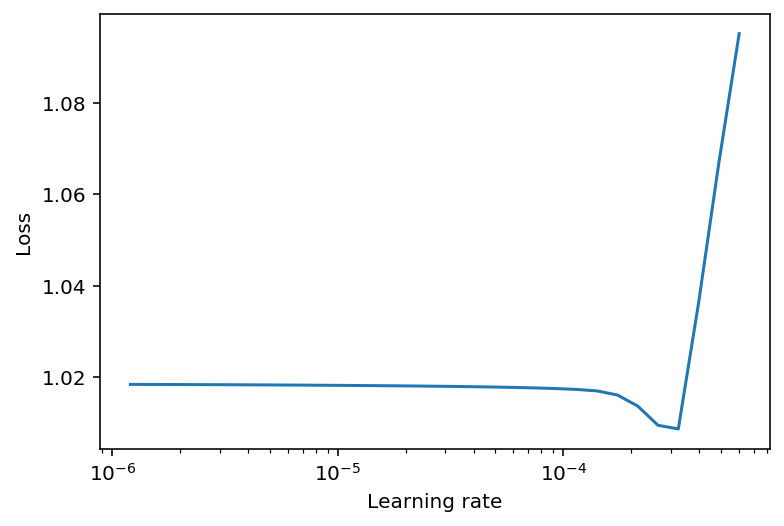

In [145]:
trainer.lr_range_test(val_loss=True)

In [164]:
trainer.train(90, 2e-4)

Epoch 0 - Train: loss=1.019505, iou=0.0512, acc=0.1004, prec=0.0512, recall=0.9901, f1=0.0975


Epoch 0 - Valid: loss=1.013118, iou=0.0463, acc=0.0785, prec=0.0463, recall=1.0000, f1=0.0885


Epoch 1 - Train: loss=0.985460, iou=0.0628, acc=0.2717, prec=0.0628, recall=0.9950, f1=0.1182


Epoch 1 - Valid: loss=0.983961, iou=0.0715, acc=0.4197, prec=0.0715, recall=0.9984, f1=0.1335


Recreated random crops!


Epoch 2 - Train: loss=0.933203, iou=0.0923, acc=0.5253, prec=0.0923, recall=0.9945, f1=0.1690


Epoch 2 - Valid: loss=0.903235, iou=0.1131, acc=0.6495, prec=0.1131, recall=0.9988, f1=0.2033


Epoch 3 - Train: loss=0.887362, iou=0.1354, acc=0.6942, prec=0.1357, recall=0.9871, f1=0.2386


Epoch 3 - Valid: loss=0.890568, iou=0.1199, acc=0.6716, prec=0.1199, recall=0.9992, f1=0.2141


Recreated random crops!


Epoch 4 - Train: loss=0.844686, iou=0.1946, acc=0.7814, prec=0.1947, recall=0.9974, f1=0.3258


Epoch 4 - Valid: loss=0.919499, iou=0.1065, acc=0.6249, prec=0.1065, recall=0.9989, f1=0.1925


Epoch 5 - Train: loss=0.838198, iou=0.1831, acc=0.7690, prec=0.1839, recall=0.9775, f1=0.3095


Epoch 5 - Valid: loss=0.870307, iou=0.1247, acc=0.6867, prec=0.1247, recall=0.9970, f1=0.2217


Recreated random crops!


Epoch 6 - Train: loss=0.801853, iou=0.2064, acc=0.7977, prec=0.2067, recall=0.9941, f1=0.3422


Epoch 6 - Valid: loss=0.800282, iou=0.1396, acc=0.7257, prec=0.1397, recall=0.9946, f1=0.2450


Epoch 7 - Train: loss=0.773586, iou=0.2126, acc=0.8049, prec=0.2128, recall=0.9952, f1=0.3507


Epoch 7 - Valid: loss=0.718286, iou=0.1924, acc=0.8152, prec=0.1930, recall=0.9834, f1=0.3226


Recreated random crops!


Epoch 8 - Train: loss=0.737343, iou=0.2402, acc=0.8451, prec=0.2411, recall=0.9845, f1=0.3874


Epoch 8 - Valid: loss=0.667063, iou=0.2258, acc=0.8502, prec=0.2271, recall=0.9756, f1=0.3684


Epoch 9 - Train: loss=0.683731, iou=0.2747, acc=0.8704, prec=0.2758, recall=0.9865, f1=0.4311


Epoch 9 - Valid: loss=0.636046, iou=0.2371, acc=0.8572, prec=0.2376, recall=0.9917, f1=0.3833


Recreated random crops!


Epoch 10 - Train: loss=0.630448, iou=0.3045, acc=0.8893, prec=0.3073, recall=0.9709, f1=0.4669


Epoch 10 - Valid: loss=0.639032, iou=0.2106, acc=0.8334, prec=0.2109, recall=0.9927, f1=0.3479


Epoch 11 - Train: loss=0.562438, iou=0.3570, acc=0.9161, prec=0.3663, recall=0.9334, f1=0.5261


Epoch 11 - Valid: loss=0.509688, iou=0.3481, acc=0.9219, prec=0.3573, recall=0.9314, f1=0.5165


Recreated random crops!


Epoch 12 - Train: loss=0.533381, iou=0.3440, acc=0.9035, prec=0.3510, recall=0.9454, f1=0.5119


Epoch 12 - Valid: loss=0.533813, iou=0.3971, acc=0.9467, prec=0.4457, recall=0.7847, f1=0.5685


Epoch 13 - Train: loss=0.472983, iou=0.3964, acc=0.9241, prec=0.4082, recall=0.9318, f1=0.5677


Epoch 13 - Valid: loss=0.566791, iou=0.4919, acc=0.9698, prec=0.6654, recall=0.6536, f1=0.6594


Recreated random crops!


Epoch 14 - Train: loss=0.441757, iou=0.4458, acc=0.9445, prec=0.4711, recall=0.8928, f1=0.6167


Epoch 14 - Valid: loss=0.446834, iou=0.4848, acc=0.9613, prec=0.5455, recall=0.8132, f1=0.6530


Epoch 15 - Train: loss=0.501155, iou=0.4188, acc=0.9402, prec=0.4489, recall=0.8619, f1=0.5903


Epoch 15 - Valid: loss=0.460086, iou=0.5060, acc=0.9666, prec=0.5990, recall=0.7651, f1=0.6720


Recreated random crops!


Epoch 16 - Train: loss=0.457440, iou=0.4376, acc=0.9341, prec=0.4567, recall=0.9124, f1=0.6087


Epoch 16 - Valid: loss=0.481429, iou=0.5377, acc=0.9730, prec=0.6965, recall=0.7023, f1=0.6994


Epoch 17 - Train: loss=0.454319, iou=0.4158, acc=0.9254, prec=0.4261, recall=0.9450, f1=0.5874


Epoch 17 - Valid: loss=0.500730, iou=0.5276, acc=0.9722, prec=0.6888, recall=0.6927, f1=0.6907


Recreated random crops!


Epoch 18 - Train: loss=0.407381, iou=0.4933, acc=0.9557, prec=0.5362, recall=0.8604, f1=0.6606


Epoch 18 - Valid: loss=0.414199, iou=0.5811, acc=0.9753, prec=0.7060, recall=0.7666, f1=0.7350


Epoch 19 - Train: loss=0.316407, iou=0.5724, acc=0.9659, prec=0.6056, recall=0.9125, f1=0.7281


Epoch 19 - Valid: loss=0.449369, iou=0.5168, acc=0.9669, prec=0.5990, recall=0.7900, f1=0.6814


Recreated random crops!


Epoch 20 - Train: loss=0.370386, iou=0.5537, acc=0.9622, prec=0.5954, recall=0.8876, f1=0.7127


Epoch 20 - Valid: loss=0.331852, iou=0.5798, acc=0.9717, prec=0.6343, recall=0.8710, f1=0.7340


Epoch 21 - Train: loss=0.350065, iou=0.5300, acc=0.9571, prec=0.5568, recall=0.9166, f1=0.6928


Epoch 21 - Valid: loss=0.414104, iou=0.4040, acc=0.9384, prec=0.4162, recall=0.9322, f1=0.5755


Recreated random crops!


Epoch 22 - Train: loss=0.315197, iou=0.5799, acc=0.9696, prec=0.6206, recall=0.8984, f1=0.7341


Epoch 22 - Valid: loss=0.426667, iou=0.5374, acc=0.9683, prec=0.6082, recall=0.8220, f1=0.6991


Epoch 23 - Train: loss=0.314898, iou=0.5657, acc=0.9667, prec=0.5912, recall=0.9291, f1=0.7226


Epoch 23 - Valid: loss=0.327303, iou=0.5554, acc=0.9678, prec=0.5922, recall=0.8992, f1=0.7141


Recreated random crops!


Epoch 24 - Train: loss=0.297483, iou=0.5929, acc=0.9686, prec=0.6289, recall=0.9119, f1=0.7444


Epoch 24 - Valid: loss=0.436519, iou=0.6209, acc=0.9799, prec=0.8006, recall=0.7345, f1=0.7661


Epoch 25 - Train: loss=0.265293, iou=0.6245, acc=0.9719, prec=0.6556, recall=0.9294, f1=0.7688


Epoch 25 - Valid: loss=0.624743, iou=0.5589, acc=0.9776, prec=0.8265, recall=0.6332, f1=0.7170


Recreated random crops!


Epoch 26 - Train: loss=0.303914, iou=0.5830, acc=0.9650, prec=0.6135, recall=0.9213, f1=0.7366


Epoch 26 - Valid: loss=0.424104, iou=0.6300, acc=0.9804, prec=0.8048, recall=0.7437, f1=0.7730


Epoch 27 - Train: loss=0.267798, iou=0.6244, acc=0.9702, prec=0.6537, recall=0.9331, f1=0.7688


Epoch 27 - Valid: loss=0.549279, iou=0.5981, acc=0.9795, prec=0.8325, recall=0.6799, f1=0.7485


Recreated random crops!


Epoch 28 - Train: loss=0.282820, iou=0.6045, acc=0.9724, prec=0.6428, recall=0.9104, f1=0.7535


Epoch 28 - Valid: loss=0.355824, iou=0.6033, acc=0.9752, prec=0.6799, recall=0.8426, f1=0.7526


Epoch 29 - Train: loss=0.244781, iou=0.6479, acc=0.9769, prec=0.6874, recall=0.9185, f1=0.7863


Epoch 29 - Valid: loss=0.430257, iou=0.6401, acc=0.9806, prec=0.7914, recall=0.7700, f1=0.7805


Recreated random crops!


Epoch 30 - Train: loss=0.297262, iou=0.5959, acc=0.9698, prec=0.6334, recall=0.9096, f1=0.7468


Epoch 30 - Valid: loss=0.650873, iou=0.5459, acc=0.9767, prec=0.8120, recall=0.6249, f1=0.7062


Epoch 31 - Train: loss=0.294412, iou=0.6199, acc=0.9728, prec=0.6623, recall=0.9063, f1=0.7654


Epoch 31 - Valid: loss=0.506022, iou=0.6166, acc=0.9808, prec=0.8507, recall=0.6914, f1=0.7628


Recreated random crops!


Epoch 32 - Train: loss=0.269760, iou=0.6313, acc=0.9740, prec=0.6678, recall=0.9201, f1=0.7739


Epoch 32 - Valid: loss=0.383098, iou=0.5249, acc=0.9657, prec=0.5795, recall=0.8477, f1=0.6884


Epoch 33 - Train: loss=0.234958, iou=0.6676, acc=0.9778, prec=0.7076, recall=0.9220, f1=0.8007


Epoch 33 - Valid: loss=0.405268, iou=0.6200, acc=0.9789, prec=0.7621, recall=0.7688, f1=0.7654


Recreated random crops!


Epoch 34 - Train: loss=0.243154, iou=0.6682, acc=0.9758, prec=0.7065, recall=0.9249, f1=0.8011


Epoch 34 - Valid: loss=0.337882, iou=0.6136, acc=0.9762, prec=0.6929, recall=0.8427, f1=0.7605


Epoch 35 - Train: loss=0.221586, iou=0.6740, acc=0.9759, prec=0.7017, recall=0.9447, f1=0.8053


Epoch 35 - Valid: loss=0.339312, iou=0.6639, acc=0.9818, prec=0.7924, recall=0.8036, f1=0.7980


Recreated random crops!


Epoch 36 - Train: loss=0.210292, iou=0.6809, acc=0.9811, prec=0.7134, recall=0.9373, f1=0.8102


Epoch 36 - Valid: loss=0.365701, iou=0.6542, acc=0.9812, prec=0.7861, recall=0.7959, f1=0.7910


Epoch 37 - Train: loss=0.229064, iou=0.6671, acc=0.9800, prec=0.7029, recall=0.9292, f1=0.8003


Epoch 37 - Valid: loss=0.540309, iou=0.6049, acc=0.9803, prec=0.8570, recall=0.6728, f1=0.7538


Recreated random crops!


Epoch 38 - Train: loss=0.256158, iou=0.6476, acc=0.9763, prec=0.6926, recall=0.9088, f1=0.7861


Epoch 38 - Valid: loss=0.425132, iou=0.6412, acc=0.9810, prec=0.8067, recall=0.7576, f1=0.7814


Epoch 39 - Train: loss=0.254155, iou=0.6471, acc=0.9756, prec=0.6796, recall=0.9312, f1=0.7858


Epoch 39 - Valid: loss=0.490955, iou=0.6141, acc=0.9807, prec=0.8553, recall=0.6853, f1=0.7609


Recreated random crops!


Epoch 40 - Train: loss=0.235904, iou=0.6631, acc=0.9772, prec=0.6970, recall=0.9316, f1=0.7974


Epoch 40 - Valid: loss=0.481182, iou=0.6343, acc=0.9810, prec=0.8189, recall=0.7379, f1=0.7763


Epoch 41 - Train: loss=0.217228, iou=0.6743, acc=0.9782, prec=0.7070, recall=0.9357, f1=0.8054


Epoch 41 - Valid: loss=0.478133, iou=0.6268, acc=0.9796, prec=0.7764, recall=0.7650, f1=0.7706


Recreated random crops!


Epoch 42 - Train: loss=0.233787, iou=0.6648, acc=0.9800, prec=0.7080, recall=0.9160, f1=0.7987


Epoch 42 - Valid: loss=0.489271, iou=0.6187, acc=0.9795, prec=0.7870, recall=0.7432, f1=0.7645


Epoch 43 - Train: loss=0.222461, iou=0.6918, acc=0.9823, prec=0.7373, recall=0.9181, f1=0.8178


Epoch 43 - Valid: loss=0.457546, iou=0.5877, acc=0.9750, prec=0.6919, recall=0.7960, f1=0.7403


Recreated random crops!


Epoch 44 - Train: loss=0.208128, iou=0.6914, acc=0.9777, prec=0.7213, recall=0.9435, f1=0.8176


Epoch 44 - Valid: loss=0.338589, iou=0.6651, acc=0.9813, prec=0.7685, recall=0.8318, f1=0.7989


Epoch 45 - Train: loss=0.193659, iou=0.7054, acc=0.9789, prec=0.7322, recall=0.9507, f1=0.8273


Epoch 45 - Valid: loss=0.424323, iou=0.6568, acc=0.9815, prec=0.7963, recall=0.7895, f1=0.7929


Recreated random crops!


Epoch 46 - Train: loss=0.212342, iou=0.7011, acc=0.9797, prec=0.7397, recall=0.9307, f1=0.8243


Epoch 46 - Valid: loss=0.534803, iou=0.6282, acc=0.9805, prec=0.8108, recall=0.7360, f1=0.7716


Epoch 47 - Train: loss=0.242314, iou=0.6644, acc=0.9759, prec=0.6995, recall=0.9299, f1=0.7984


Epoch 47 - Valid: loss=0.578449, iou=0.5544, acc=0.9728, prec=0.6749, recall=0.7565, f1=0.7134


Recreated random crops!


Epoch 48 - Train: loss=0.271439, iou=0.6157, acc=0.9722, prec=0.6461, recall=0.9289, f1=0.7621


Epoch 48 - Valid: loss=0.492297, iou=0.4802, acc=0.9585, prec=0.5224, recall=0.8561, f1=0.6488


Epoch 49 - Train: loss=0.251166, iou=0.6506, acc=0.9763, prec=0.6907, recall=0.9181, f1=0.7883


Epoch 49 - Valid: loss=0.595845, iou=0.5668, acc=0.9761, prec=0.7488, recall=0.6998, f1=0.7235


Recreated random crops!


Epoch 50 - Train: loss=0.246287, iou=0.6472, acc=0.9757, prec=0.6856, recall=0.9204, f1=0.7858


Epoch 50 - Valid: loss=0.365247, iou=0.6365, acc=0.9798, prec=0.7674, recall=0.7886, f1=0.7779


Epoch 51 - Train: loss=0.264682, iou=0.6119, acc=0.9712, prec=0.6386, recall=0.9360, f1=0.7592


Epoch 51 - Valid: loss=0.330593, iou=0.6242, acc=0.9772, prec=0.7036, recall=0.8469, f1=0.7686


Recreated random crops!


Epoch 52 - Train: loss=0.251701, iou=0.6586, acc=0.9768, prec=0.6967, recall=0.9235, f1=0.7942


Epoch 52 - Valid: loss=0.384432, iou=0.6447, acc=0.9812, prec=0.8072, recall=0.7620, f1=0.7839


Epoch 53 - Train: loss=0.235791, iou=0.6842, acc=0.9796, prec=0.7338, recall=0.9101, f1=0.8125


Epoch 53 - Valid: loss=0.307638, iou=0.6314, acc=0.9776, prec=0.7049, recall=0.8582, f1=0.7740


Recreated random crops!


Epoch 54 - Train: loss=0.247085, iou=0.6904, acc=0.9807, prec=0.7437, recall=0.9060, f1=0.8169


Epoch 54 - Valid: loss=0.340119, iou=0.5975, acc=0.9739, prec=0.6584, recall=0.8659, f1=0.7480


Epoch 55 - Train: loss=0.212302, iou=0.6642, acc=0.9773, prec=0.6911, recall=0.9445, f1=0.7982


Epoch 55 - Valid: loss=0.510903, iou=0.6391, acc=0.9817, prec=0.8428, recall=0.7256, f1=0.7798


Recreated random crops!


Epoch 56 - Train: loss=0.209325, iou=0.6914, acc=0.9784, prec=0.7259, recall=0.9358, f1=0.8176


Epoch 56 - Valid: loss=0.461468, iou=0.6418, acc=0.9810, prec=0.8060, recall=0.7591, f1=0.7818


Epoch 57 - Train: loss=0.193285, iou=0.7059, acc=0.9798, prec=0.7391, recall=0.9402, f1=0.8276


Epoch 57 - Valid: loss=0.394517, iou=0.6605, acc=0.9818, prec=0.7985, recall=0.7926, f1=0.7956


Recreated random crops!


Epoch 58 - Train: loss=0.196468, iou=0.7102, acc=0.9812, prec=0.7452, recall=0.9378, f1=0.8305


Epoch 58 - Valid: loss=0.434413, iou=0.6599, acc=0.9824, prec=0.8303, recall=0.7627, f1=0.7951


Epoch 59 - Train: loss=0.198793, iou=0.6988, acc=0.9800, prec=0.7297, recall=0.9430, f1=0.8227


Epoch 59 - Valid: loss=0.436389, iou=0.6313, acc=0.9793, prec=0.7579, recall=0.7908, f1=0.7740


Recreated random crops!


Epoch 60 - Train: loss=0.190756, iou=0.7091, acc=0.9815, prec=0.7417, recall=0.9416, f1=0.8298


Epoch 60 - Valid: loss=0.396809, iou=0.6628, acc=0.9821, prec=0.8096, recall=0.7853, f1=0.7972


Epoch 61 - Train: loss=0.197959, iou=0.7032, acc=0.9808, prec=0.7304, recall=0.9496, f1=0.8257


Epoch 61 - Valid: loss=0.293343, iou=0.6699, acc=0.9809, prec=0.7460, recall=0.8678, f1=0.8023


Recreated random crops!


Epoch 62 - Train: loss=0.195320, iou=0.7250, acc=0.9834, prec=0.7710, recall=0.9239, f1=0.8405


Epoch 62 - Valid: loss=0.308318, iou=0.6489, acc=0.9790, prec=0.7213, recall=0.8660, f1=0.7871


Epoch 63 - Train: loss=0.200067, iou=0.6974, acc=0.9806, prec=0.7287, recall=0.9421, f1=0.8218


Epoch 63 - Valid: loss=0.314462, iou=0.6781, acc=0.9821, prec=0.7779, recall=0.8409, f1=0.8082


Recreated random crops!


Epoch 64 - Train: loss=0.199616, iou=0.6908, acc=0.9776, prec=0.7148, recall=0.9536, f1=0.8171


Epoch 64 - Valid: loss=0.319353, iou=0.6801, acc=0.9824, prec=0.7854, recall=0.8354, f1=0.8096


Epoch 65 - Train: loss=0.195876, iou=0.7093, acc=0.9798, prec=0.7448, recall=0.9371, f1=0.8300


Epoch 65 - Valid: loss=0.355124, iou=0.6763, acc=0.9826, prec=0.8012, recall=0.8127, f1=0.8069


Recreated random crops!


Epoch 66 - Train: loss=0.184808, iou=0.6966, acc=0.9802, prec=0.7204, recall=0.9549, f1=0.8212


Epoch 66 - Valid: loss=0.413590, iou=0.6627, acc=0.9821, prec=0.8107, recall=0.7840, f1=0.7971


Epoch 67 - Train: loss=0.195134, iou=0.7129, acc=0.9818, prec=0.7420, recall=0.9478, f1=0.8324


Epoch 67 - Valid: loss=0.410059, iou=0.6674, acc=0.9828, prec=0.8298, recall=0.7732, f1=0.8005


Recreated random crops!


Epoch 68 - Train: loss=0.203895, iou=0.7208, acc=0.9811, prec=0.7664, recall=0.9237, f1=0.8377


Epoch 68 - Valid: loss=0.384868, iou=0.6570, acc=0.9815, prec=0.7963, recall=0.7898, f1=0.7930


Epoch 69 - Train: loss=0.200003, iou=0.6793, acc=0.9762, prec=0.7010, recall=0.9564, f1=0.8090


Epoch 69 - Valid: loss=0.347328, iou=0.6693, acc=0.9822, prec=0.7971, recall=0.8068, f1=0.8019


Recreated random crops!


Epoch 70 - Train: loss=0.197515, iou=0.7062, acc=0.9808, prec=0.7421, recall=0.9359, f1=0.8278


Epoch 70 - Valid: loss=0.357357, iou=0.6779, acc=0.9831, prec=0.8196, recall=0.7968, f1=0.8081


Epoch 71 - Train: loss=0.252198, iou=0.6754, acc=0.9774, prec=0.6981, recall=0.9539, f1=0.8062


Epoch 71 - Valid: loss=0.296337, iou=0.6430, acc=0.9783, prec=0.7082, recall=0.8747, f1=0.7827


Recreated random crops!


Epoch 72 - Train: loss=0.196875, iou=0.6760, acc=0.9784, prec=0.6942, recall=0.9627, f1=0.8067


Epoch 72 - Valid: loss=0.327521, iou=0.6737, acc=0.9820, prec=0.7833, recall=0.8280, f1=0.8050


Epoch 73 - Train: loss=0.184838, iou=0.7280, acc=0.9837, prec=0.7705, recall=0.9296, f1=0.8426


Epoch 73 - Valid: loss=0.385368, iou=0.6748, acc=0.9830, prec=0.8252, recall=0.7874, f1=0.8058


Recreated random crops!


Epoch 74 - Train: loss=0.190845, iou=0.7151, acc=0.9820, prec=0.7489, recall=0.9406, f1=0.8339


Epoch 74 - Valid: loss=0.371099, iou=0.6728, acc=0.9824, prec=0.8011, recall=0.8077, f1=0.8044


Epoch 75 - Train: loss=0.190474, iou=0.7050, acc=0.9809, prec=0.7317, recall=0.9508, f1=0.8270


Epoch 75 - Valid: loss=0.409514, iou=0.6727, acc=0.9830, prec=0.8280, recall=0.7819, f1=0.8043


Recreated random crops!


Epoch 76 - Train: loss=0.211213, iou=0.7130, acc=0.9807, prec=0.7443, recall=0.9444, f1=0.8325


Epoch 76 - Valid: loss=0.385701, iou=0.6777, acc=0.9831, prec=0.8242, recall=0.7923, f1=0.8079


Epoch 77 - Train: loss=0.184615, iou=0.7195, acc=0.9813, prec=0.7513, recall=0.9444, f1=0.8369


Epoch 77 - Valid: loss=0.393324, iou=0.6760, acc=0.9830, prec=0.8220, recall=0.7919, f1=0.8067


Recreated random crops!


Epoch 78 - Train: loss=0.185724, iou=0.7155, acc=0.9816, prec=0.7457, recall=0.9465, f1=0.8342


Epoch 78 - Valid: loss=0.373197, iou=0.6776, acc=0.9829, prec=0.8129, recall=0.8027, f1=0.8078


Epoch 79 - Train: loss=0.183031, iou=0.7135, acc=0.9813, prec=0.7396, recall=0.9530, f1=0.8328


Epoch 79 - Valid: loss=0.355021, iou=0.6780, acc=0.9827, prec=0.8018, recall=0.8145, f1=0.8081


Recreated random crops!


Epoch 80 - Train: loss=0.180510, iou=0.7169, acc=0.9802, prec=0.7438, recall=0.9520, f1=0.8351


Epoch 80 - Valid: loss=0.361343, iou=0.6810, acc=0.9831, prec=0.8151, recall=0.8055, f1=0.8102


Epoch 81 - Train: loss=0.188274, iou=0.7181, acc=0.9804, prec=0.7499, recall=0.9443, f1=0.8359


Epoch 81 - Valid: loss=0.369136, iou=0.6809, acc=0.9832, prec=0.8187, recall=0.8018, f1=0.8101


Recreated random crops!


Epoch 82 - Train: loss=0.184463, iou=0.7140, acc=0.9816, prec=0.7453, recall=0.9445, f1=0.8331


Epoch 82 - Valid: loss=0.364288, iou=0.6831, acc=0.9833, prec=0.8190, recall=0.8045, f1=0.8117


Epoch 83 - Train: loss=0.182678, iou=0.7180, acc=0.9820, prec=0.7497, recall=0.9444, f1=0.8359


Epoch 83 - Valid: loss=0.359644, iou=0.6825, acc=0.9832, prec=0.8142, recall=0.8084, f1=0.8113


Recreated random crops!


Epoch 84 - Train: loss=0.186015, iou=0.7112, acc=0.9821, prec=0.7430, recall=0.9432, f1=0.8312


Epoch 84 - Valid: loss=0.348165, iou=0.6818, acc=0.9829, prec=0.8031, recall=0.8187, f1=0.8108


Epoch 85 - Train: loss=0.181387, iou=0.7159, acc=0.9826, prec=0.7482, recall=0.9431, f1=0.8344


Epoch 85 - Valid: loss=0.352727, iou=0.6806, acc=0.9829, prec=0.8037, recall=0.8163, f1=0.8100


Recreated random crops!


Epoch 86 - Train: loss=0.179333, iou=0.7159, acc=0.9825, prec=0.7443, recall=0.9494, f1=0.8344


Epoch 86 - Valid: loss=0.353546, iou=0.6819, acc=0.9830, prec=0.8074, recall=0.8144, f1=0.8109


Epoch 87 - Train: loss=0.176197, iou=0.7187, acc=0.9828, prec=0.7476, recall=0.9490, f1=0.8363


Epoch 87 - Valid: loss=0.358205, iou=0.6817, acc=0.9831, prec=0.8115, recall=0.8099, f1=0.8107


Recreated random crops!


Epoch 88 - Train: loss=0.179963, iou=0.7120, acc=0.9816, prec=0.7413, recall=0.9474, f1=0.8318


Epoch 88 - Valid: loss=0.366342, iou=0.6810, acc=0.9831, prec=0.8157, recall=0.8048, f1=0.8102


Epoch 89 - Train: loss=0.174620, iou=0.7155, acc=0.9817, prec=0.7407, recall=0.9546, f1=0.8341


Epoch 89 - Valid: loss=0.361512, iou=0.6812, acc=0.9831, prec=0.8139, recall=0.8069, f1=0.8103


Recreated random crops!


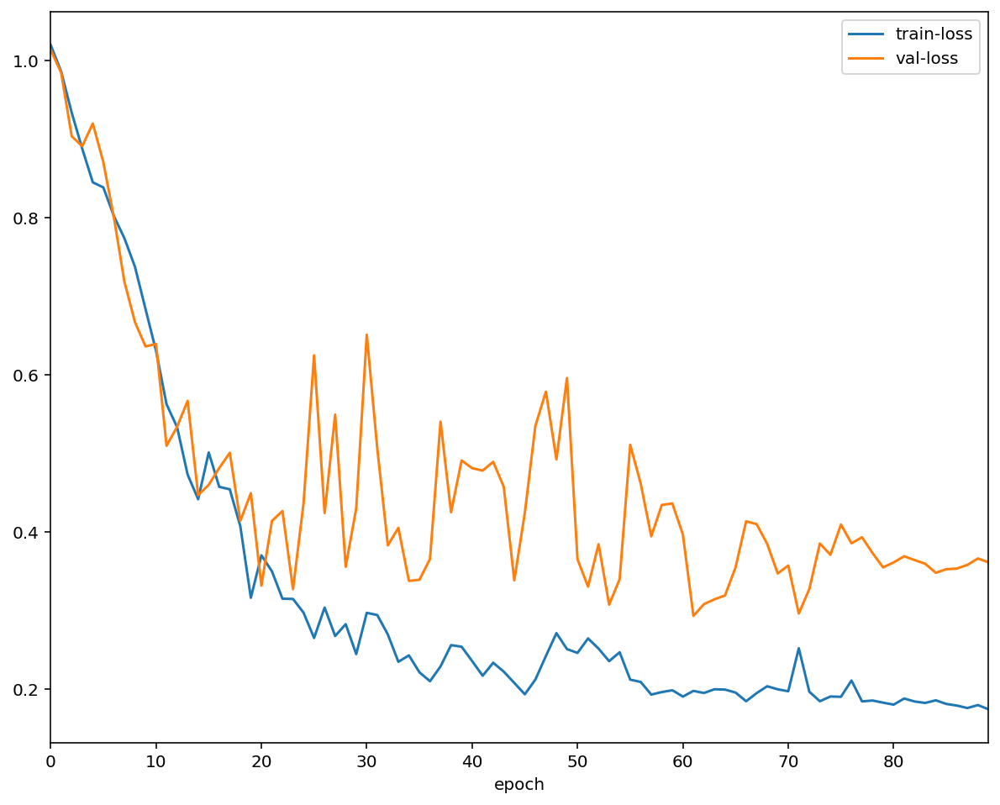

In [165]:
trainer.recorder.show_train_val_metric_curve()

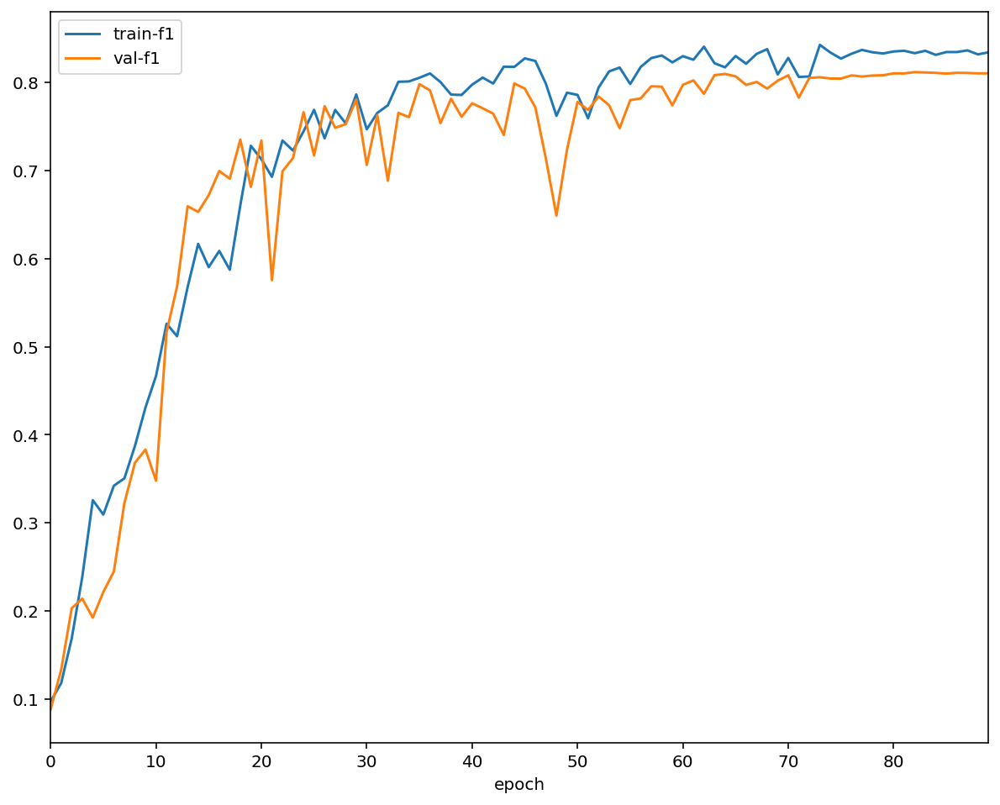

In [166]:
trainer.recorder.show_train_val_metric_curve(metric="f1")

## Predict

In [0]:
def predict_image(imageId, transforms=tf_valid, 
                  model=trainer.model, device="cuda", threshold=0.5):
    img = M(imageId)
    mask = generate_mask_for_image_and_class(img.shape[:2], imageId)

    criterion = trainer.criterion
    img, mask = transforms(img, mask)

    img.unsqueeze_(0)
    
    model.eval()

    recorder = MetricRecorder(metrics=[IOUMetric(), AccuracyMetric(), PrecisionRecallF1Metric()])

    with torch.no_grad():
        img, mask = img.to(device), mask.to(device)

        pred = model(img).squeeze()

        loss = criterion(pred, mask.type(torch.float32))

        recorder.update_record_on_batch_end(0, loss.item(), mask, 
                                            pred, 1, 1, threshold=threshold, training=False)
        recorder.finalize_record_on_epoch_end(training=False)

        pred_mask = (torch.sigmoid(pred).cpu() > threshold)

    df_result = recorder.get_records_dataframe(training=False).reset_index(drop=True)

    return pred_mask, df_result


def show_actual_and_prediction(index, ds_test=ds_valid, model=trainer.model, 
                               device="cuda", threshold=0.5, figsize=(15, 7)):
    img_path = ds_test.imageFiles[index]
    mask_path = ds_test.maskDir / f"{img_path.stem}.png"

    img_stretched = stretch_n(tifffile.imread(os.path.join(img_path))[:, :, :3])
    mask = Image.open(mask_path)

    fig, ax = plt.subplots(ncols=2, figsize=figsize)
    tifffile.imshow(img_stretched, figure=fig, subplot=ax[0])
    ax[0].imshow(mask, alpha=0.4)
    ax[0].axis("off")

    img, _ = ds_test[index]
    img.unsqueeze_(0)

    model.eval()

    with torch.no_grad():
        img = img.to(device)
        pred_mask = torch.sigmoid(model(img)).squeeze().cpu()

    tifffile.imshow(img_stretched, figure=fig, subplot=ax[1])
    ax[1].imshow((pred_mask > threshold), alpha=0.4)
    ax[1].axis("off")
    plt.tight_layout()
    plt.show()


def show_actual_and_prediction_single_image(imageId, model=trainer.model, device="cuda", 
                                            threshold=0.5, figsize=(15, 7)):
    img = M(imageId)
    mask = generate_mask_for_image_and_class(img.shape[:2], imageId)
    img_stretched = stretch_n(img)

    pred, _ = predict_image(imageId, model=model, device=device, threshold=threshold)

    fig, ax = plt.subplots(ncols=2, figsize=figsize)

    tifffile.imshow(img_stretched, figure=fig, subplot=ax[0])
    ax[0].imshow(mask, alpha=0.4)
    ax[0].axis("off")

    tifffile.imshow(img_stretched, figure=fig, subplot=ax[1])
    ax[1].imshow(pred, alpha=0.4)
    ax[1].axis("off")
    plt.tight_layout()
    plt.show()    

In [0]:
def calculate_optimal_threshold(dl_test=dl_valid, model=trainer.model, device="cuda", 
                                start_val=0.0, end_val=1.0, step_size=0.05,
                                metric_to_maximize="f1"):
    criterion = trainer.criterion
    model.eval()

    test_thresholds = np.arange(start_val, end_val, step_size)

    recorder = MetricRecorder(metrics=[IOUMetric(), AccuracyMetric(), PrecisionRecallF1Metric()])

    for i, t in tqdm(enumerate(test_thresholds), leave=False, position=0):
        with torch.no_grad():
            for img, mask in dl_test:
                img, mask = img.to(device), mask.to(device)
                pred = model(img).squeeze()

                loss = criterion(pred, mask.type(torch.float32))

                recorder.update_record_on_batch_end(i, loss.item(), mask, 
                                                pred, img.size(0), len(dl_test.dataset), threshold=t, training=False)    
            recorder.finalize_record_on_epoch_end(training=False)


                
    df_recorder = recorder.get_records_dataframe(training=False)
    df_recorder["threshold"] = test_thresholds
    df_recorder = df_recorder.reset_index(drop=True)

    f1_maximizing_threshold = test_thresholds[df_recorder[metric_to_maximize].idxmax()]

    return f1_maximizing_threshold, df_recorder 

def calculate_optimal_threshold_single_image(imageId=df_val_buildings.iloc[0].ImageId, 
                                             model=trainer.model, device="cuda", start_val=0.0, 
                                             end_val=1.0, step_size=0.05, metric_to_maximize="f1"):
    criterion = trainer.criterion
    model.eval()

    test_thresholds = np.arange(start_val, end_val, step_size)
    recorder = MetricRecorder(metrics=[IOUMetric(), AccuracyMetric(), PrecisionRecallF1Metric()])

    
    with torch.no_grad():
        img = M(imageId)
        mask = generate_mask_for_image_and_class(img.shape[:2], imageId)

        img, mask = tf_valid(img, mask)

        img.unsqueeze_(0)

        img, mask = img.to(device), mask.to(device)
        pred = model(img).squeeze()

        loss = criterion(pred, mask.type(torch.float32))

        for i, t in tqdm(enumerate(test_thresholds), leave=False, position=0):
            recorder.update_record_on_batch_end(i, loss.item(), mask, 
                                                pred, 1, 1, threshold=t, training=False)
            recorder.finalize_record_on_epoch_end(training=False)

    df_recorder = recorder.get_records_dataframe(training=False)
    df_recorder["threshold"] = test_thresholds
    df_recorder = df_recorder.reset_index(drop=True)

    maximizing_threshold = test_thresholds[df_recorder[metric_to_maximize].idxmax()]

    return maximizing_threshold, df_recorder 

In [169]:
opt_threshold, df_threshold = calculate_optimal_threshold(start_val=0.4, end_val=1.0, step_size=0.05)

In [170]:
print(f"Optimal threshold for maximal f1-score: {opt_threshold:.2}")

Optimal threshold for maximal f1-score: 0.6


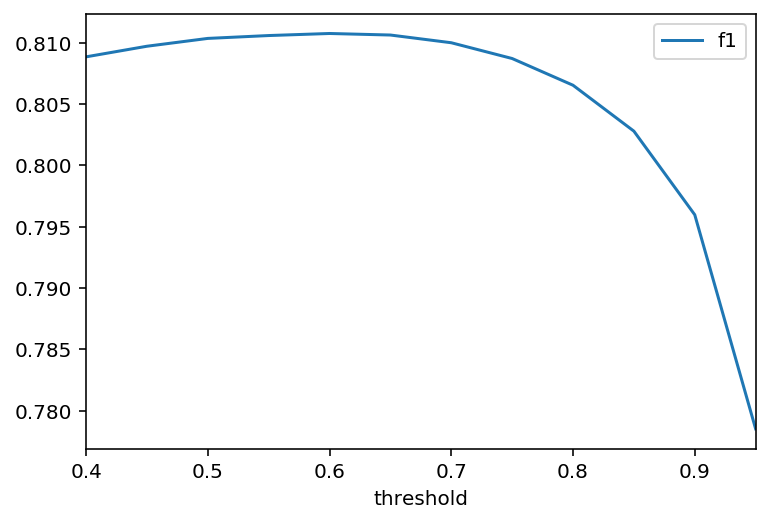

In [171]:
df_threshold.plot(x="threshold", y="f1")
plt.show()

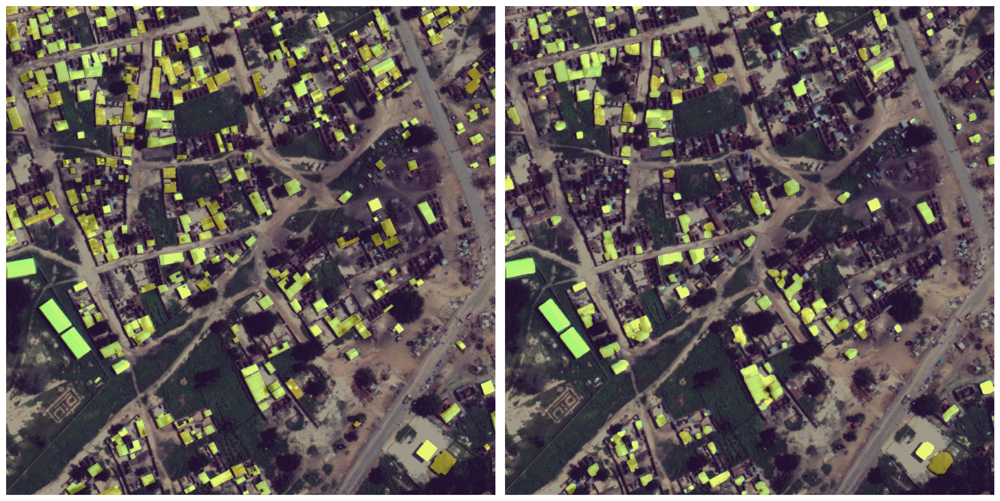

In [172]:
show_actual_and_prediction(2, threshold=opt_threshold, figsize=(16, 9))

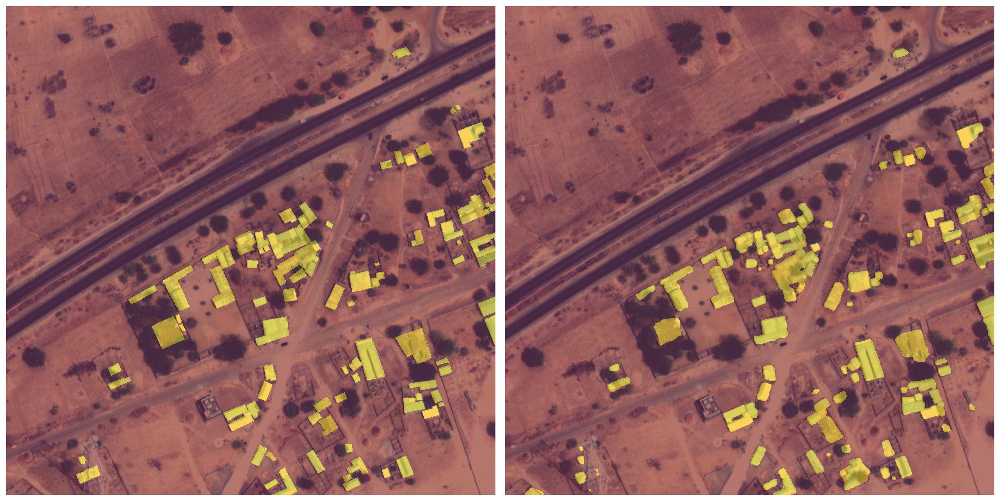

In [173]:
show_actual_and_prediction(12, threshold=opt_threshold, figsize=(16, 9))